## Lowest common demoninator of LSOA 2011 and 2021 boundaries 

In [6]:
#import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import geopandas as gpd
import os
import geojson
import pyreadr 
from shapely.geometry import Polygon

In [4]:
#set working directory
os.chdir("M:\lsoa_common")

lsoa_lookup = pd.read_csv("LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv")
lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")

C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\1466142596.py:5: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\1466142596.py:6: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")


In [7]:
lsoa_01_to_21 = pyreadr.read_r('mye\population_LSOA11_01_to_20.rds') 


In [8]:
#convert lsoa_01_to_21 to df
lsoa_01_to_21_df = lsoa_01_to_21[None]

In [42]:
lsoa_2021_geog2021

,LAD 2021 Code,LAD 2021 Name,LSOA 2021 Code,LSOA 2021 Name,Total,population,sex,age,year
0,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",5,female,0,2021
1,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,1,2021
2,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,2,2021
3,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,3,2021
4,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",0,female,4,2021
...,...,...,...,...,...,...,...,...,...
6492299,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",5,male,86,2021
6492300,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,87,2021
6492301,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,88,2021
6492302,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,89,2021


In [43]:
lsoa_2022_geog2021.columns.to_list()

['LAD 2021 Code',
 'LAD 2021 Name',
 'LSOA 2021 Code',
 'LSOA 2021 Name',
 'Total',
 'population',
 'sex',
 'age',
 'year']

In [45]:
#rename columns 'LSOA 2021 Code','LSOA 2021 Name' to 'LSOA21CD','LSOA21NM'
lsoa_2021_geog2021 = lsoa_2021_geog2021.rename(columns={'LSOA 2021 Code':'LSOA21CD','LSOA 2021 Name':'LSOA21NM'})

In [46]:
lsoa_01_to_21_df

,sex,age,year,LSOA11CD,MSOA11CD,LAD11CD,LAD11NM,population
0,female,0.0,2001.0,E01000001,E02000001,E09000001,City of London,5.0
1,female,0.0,2001.0,E01000002,E02000001,E09000001,City of London,8.0
2,female,0.0,2001.0,E01000003,E02000001,E09000001,City of London,5.0
3,female,0.0,2001.0,E01000005,E02000001,E09000001,City of London,8.0
4,female,0.0,2001.0,E01000006,E02000017,E09000002,Barking and Dagenham,9.0
...,...,...,...,...,...,...,...,...
126500915,male,90.0,2020.0,W01001954,W02000372,W06000015,Cardiff,8.0
126500916,male,90.0,2020.0,W01001955,W02000192,W06000011,Swansea,0.0
126500917,male,90.0,2020.0,W01001956,W02000190,W06000011,Swansea,1.0
126500918,male,90.0,2020.0,W01001957,W02000192,W06000011,Swansea,3.0


In [47]:
lsoa_lookup

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId
0,E01000001,City of London 001A,E01000001,City of London 001A,U,E09000001,City of London,NaN,1
1,E01000002,City of London 001B,E01000002,City of London 001B,U,E09000001,City of London,NaN,2
2,E01000003,City of London 001C,E01000003,City of London 001C,U,E09000001,City of London,NaN,3
3,E01000005,City of London 001E,E01000005,City of London 001E,U,E09000001,City of London,NaN,4
4,E01000006,Barking and Dagenham 016A,E01000006,Barking and Dagenham 016A,U,E09000002,Barking and Dagenham,NaN,5
...,...,...,...,...,...,...,...,...,...
35791,W01001922,Cardiff 032E,W01001922,Cardiff 032E,U,W06000015,Cardiff,Caerdydd,35792
35792,W01001923,Carmarthenshire 026G,W01001923,Carmarthenshire 026G,U,W06000010,Carmarthenshire,Sir Gaerfyrddin,35793
35793,W01001924,Carmarthenshire 026H,W01001924,Carmarthenshire 026H,U,W06000010,Carmarthenshire,Sir Gaerfyrddin,35794
35794,W01001925,Carmarthenshire 023F,W01001925,Carmarthenshire 023F,U,W06000010,Carmarthenshire,Sir Gaerfyrddin,35795


In [48]:
#merge lsoa_2021_geog2021 with lsoa_lookup based on 'LSOA21CD'
lsoa_2021_and_lookup = pd.merge(lsoa_2021_geog2021,lsoa_lookup,how='left',on='LSOA21CD')

In [49]:
#remve duplicates columns
lsoa_2021_and_lookup = lsoa_2021_and_lookup.loc[:,~lsoa_2021_and_lookup.columns.duplicated()]

In [50]:
lsoa_2021_and_lookup 

,LAD 2021 Code,LAD 2021 Name,LSOA21CD,LSOA21NM_x,Total,population,sex,age,year,LSOA11CD,LSOA11NM,LSOA21NM_y,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId
0,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",5,female,0,2021,E01011949,Hartlepool 009A,Hartlepool 009A,U,E06000001,Hartlepool,NaN,11403
1,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,1,2021,E01011949,Hartlepool 009A,Hartlepool 009A,U,E06000001,Hartlepool,NaN,11403
2,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,2,2021,E01011949,Hartlepool 009A,Hartlepool 009A,U,E06000001,Hartlepool,NaN,11403
3,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",10,female,3,2021,E01011949,Hartlepool 009A,Hartlepool 009A,U,E06000001,Hartlepool,NaN,11403
4,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,854",0,female,4,2021,E01011949,Hartlepool 009A,Hartlepool 009A,U,E06000001,Hartlepool,NaN,11403
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6514867,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,88,2021,W01001304,Merthyr Tydfil 006D,Merthyr Tydfil 006G,M,W06000024,Merthyr Tydfil,Merthyr Tudful,35695
6514868,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,89,2021,W01001303,Merthyr Tydfil 006C,Merthyr Tydfil 006G,M,W06000024,Merthyr Tydfil,Merthyr Tudful,35694
6514869,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",0,male,89,2021,W01001304,Merthyr Tydfil 006D,Merthyr Tydfil 006G,M,W06000024,Merthyr Tydfil,Merthyr Tudful,35695
6514870,W06000024,Merthyr Tydfil,W01001961,Merthyr Tydfil 006G,"2,338",4,male,90,2021,W01001303,Merthyr Tydfil 006C,Merthyr Tydfil 006G,M,W06000024,Merthyr Tydfil,Merthyr Tudful,35694


In [16]:
#where lsoa11cd is E01000001
lsoa_01_to_21_df.loc[lsoa_01_to_21_df['LSOA11CD'] == 'E01000001']

,sex,age,year,LSOA11CD,MSOA11CD,LAD11CD,LAD11NM,population
0,female,0.0,2001.0,E01000001,E02000001,E09000001,City of London,5.0
34753,female,1.0,2001.0,E01000001,E02000001,E09000001,City of London,9.0
69506,female,2.0,2001.0,E01000001,E02000001,E09000001,City of London,3.0
104259,female,3.0,2001.0,E01000001,E02000001,E09000001,City of London,4.0
139012,female,4.0,2001.0,E01000001,E02000001,E09000001,City of London,3.0
...,...,...,...,...,...,...,...,...
126327155,male,86.0,2020.0,E01000001,E02000001,E09000001,City of London,0.0
126361908,male,87.0,2020.0,E01000001,E02000001,E09000001,City of London,1.0
126396661,male,88.0,2020.0,E01000001,E02000001,E09000001,City of London,0.0
126431414,male,89.0,2020.0,E01000001,E02000001,E09000001,City of London,2.0


In [18]:
#filter lsoa_01_to_21 by year 2011
lsoa_01_to_21_2011 = lsoa_01_to_21_df[lsoa_01_to_21_df['year'] == 2011]

In [19]:
lsoa_01_to_21_2011

,sex,age,year,LSOA11CD,MSOA11CD,LAD11CD,LAD11NM,population
63250460,female,0.0,2011.0,E01000001,E02000001,E09000001,City of London,7.0
63250461,female,0.0,2011.0,E01000002,E02000001,E09000001,City of London,7.0
63250462,female,0.0,2011.0,E01000003,E02000001,E09000001,City of London,8.0
63250463,female,0.0,2011.0,E01000005,E02000001,E09000001,City of London,7.0
63250464,female,0.0,2011.0,E01000006,E02000017,E09000002,Barking and Dagenham,20.0
...,...,...,...,...,...,...,...,...
69575501,male,90.0,2011.0,W01001954,W02000372,W06000015,Cardiff,4.0
69575502,male,90.0,2011.0,W01001955,W02000192,W06000011,Swansea,2.0
69575503,male,90.0,2011.0,W01001956,W02000190,W06000011,Swansea,3.0
69575504,male,90.0,2011.0,W01001957,W02000192,W06000011,Swansea,3.0


In [20]:
#lsoa_01_to_21_2011 merge with lsoa_lookup based on 'LSOA11CD'
lsoa_01_to_21_2011_and_lookup = pd.merge(lsoa_01_to_21_2011,lsoa_lookup,how='left',left_on='LSOA11CD',right_on='LSOA11CD')

In [21]:
lsoa_01_to_21_2011_and_lookup

,sex,age,year,LSOA11CD,MSOA11CD,LAD11CD,LAD11NM,population,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId
0,female,0.0,2011.0,E01000001,E02000001,E09000001,City of London,7.0,City of London 001A,E01000001,City of London 001A,U,E09000001,City of London,NaN,1
1,female,0.0,2011.0,E01000002,E02000001,E09000001,City of London,7.0,City of London 001B,E01000002,City of London 001B,U,E09000001,City of London,NaN,2
2,female,0.0,2011.0,E01000003,E02000001,E09000001,City of London,8.0,City of London 001C,E01000003,City of London 001C,U,E09000001,City of London,NaN,3
3,female,0.0,2011.0,E01000005,E02000001,E09000001,City of London,7.0,City of London 001E,E01000005,City of London 001E,U,E09000001,City of London,NaN,4
4,female,0.0,2011.0,E01000006,E02000017,E09000002,Barking and Dagenham,20.0,Barking and Dagenham 016A,E01000006,Barking and Dagenham 016A,U,E09000002,Barking and Dagenham,NaN,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6514867,male,90.0,2011.0,W01001954,W02000372,W06000015,Cardiff,4.0,Cardiff 006F,W01001954,Cardiff 006F,U,W06000015,Cardiff,Caerdydd,35688
6514868,male,90.0,2011.0,W01001955,W02000192,W06000011,Swansea,2.0,Swansea 025F,W01001955,Swansea 025F,U,W06000011,Swansea,Abertawe,35689
6514869,male,90.0,2011.0,W01001956,W02000190,W06000011,Swansea,3.0,Swansea 023E,W01001956,Swansea 032C,U,W06000011,Swansea,Abertawe,35690
6514870,male,90.0,2011.0,W01001957,W02000192,W06000011,Swansea,3.0,Swansea 025G,W01001997,Swansea 025I,M,W06000011,Swansea,Abertawe,35613


In [22]:
#colums to list
lsoa_01_to_21_2011_and_lookup.columns.to_list()

['sex',
 'age',
 'year',
 'LSOA11CD',
 'MSOA11CD',
 'LAD11CD',
 'LAD11NM',
 'population',
 'LSOA11NM',
 'LSOA21CD',
 'LSOA21NM',
 'CHGIND',
 'LAD22CD',
 'LAD22NM',
 'LAD22NMW',
 'ObjectId']

In [23]:
MSOA_2021_and_lookup.columns.to_list()

['LAD 2021 Code',
 'LAD 2021 Name',
 'LSOA21CD',
 'LSOA21NM_x',
 'Total',
 'population',
 'sex',
 'age',
 'year',
 'LSOA11CD',
 'LSOA11NM',
 'LSOA21NM_y',
 'CHGIND',
 'LAD22CD',
 'LAD22NM',
 'LAD22NMW',
 'ObjectId']

In [24]:
#filter lsoa_01_to_22011_and_lookup 
lsoa_01_to_21_2011_and_lookup_filter = MSOA_01_to_21_2011_and_lookup[['MSOA11CD','MSOA21CD','CHGIND','sex',
 'age',
 'year',
 'population']]

In [25]:
#filter MSOA_2021_and_lookup
MSOA_2021_and_lookup_filter = MSOA_2021_and_lookup[['MSOA11CD','MSOA21CD','CHGIND','sex',
 'age',
 'year',
 'population']]

In [26]:
MSOA_01_to_21_2011_and_lookup_filter

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population
0,E01000001,E01000001,U,female,0.0,2011.0,7.0
1,E01000002,E01000002,U,female,0.0,2011.0,7.0
2,E01000003,E01000003,U,female,0.0,2011.0,8.0
3,E01000005,E01000005,U,female,0.0,2011.0,7.0
4,E01000006,E01000006,U,female,0.0,2011.0,20.0
...,...,...,...,...,...,...,...
6514867,W01001954,W01001954,U,male,90.0,2011.0,4.0
6514868,W01001955,W01001955,U,male,90.0,2011.0,2.0
6514869,W01001956,W01001956,U,male,90.0,2011.0,3.0
6514870,W01001957,W01001997,M,male,90.0,2011.0,3.0


In [27]:
lsoa_2021_and_lookup_filter

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population
0,E01011949,E01011949,U,female,0,2021,5
1,E01011949,E01011949,U,female,1,2021,10
2,E01011949,E01011949,U,female,2,2021,10
3,E01011949,E01011949,U,female,3,2021,10
4,E01011949,E01011949,U,female,4,2021,0
...,...,...,...,...,...,...,...
6514867,W01001304,W01001961,M,male,88,2021,0
6514868,W01001303,W01001961,M,male,89,2021,0
6514869,W01001304,W01001961,M,male,89,2021,0
6514870,W01001303,W01001961,M,male,90,2021,4


In [28]:
#filter chgind M or S
lsoa_01_to_21_2011_and_lookup_filter_SM = lsoa_01_to_21_2011_and_lookup_filter[(lsoa_01_to_21_2011_and_lookup_filter['CHGIND'] == 'M') | (lsoa_01_to_21_2011_and_lookup_filter['CHGIND'] == 'S')]
lsoa_2021_and_lookup_filter_SM = lsoa_2021_and_lookup_filter[(lsoa_2021_and_lookup_filter['CHGIND'] == 'M') | (lsoa_2021_and_lookup_filter['CHGIND'] == 'S')]

In [29]:
lsoa_01_to_21_2011_and_lookup_filter_SM

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population
8,E01000010,E01034473,S,female,0.0,2011.0,37.0
9,E01000010,E01034474,S,female,0.0,2011.0,37.0
22,E01000023,E01034472,S,female,0.0,2011.0,18.0
23,E01000023,E01034471,S,female,0.0,2011.0,18.0
46,E01000048,E01034479,M,female,0.0,2011.0,22.0
...,...,...,...,...,...,...,...
6514851,W01001939,W01002019,M,male,90.0,2011.0,1.0
6514853,W01001941,W01002019,M,male,90.0,2011.0,0.0
6514857,W01001945,W01002024,S,male,90.0,2011.0,0.0
6514858,W01001945,W01002025,S,male,90.0,2011.0,0.0


In [30]:
lsoa_2021_and_lookup_filter_SM

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population
10192,E01011973,E01035188,M,female,0,2021,16
10193,E01011976,E01035188,M,female,0,2021,16
10194,E01011973,E01035188,M,female,1,2021,5
10195,E01011976,E01035188,M,female,1,2021,5
10196,E01011973,E01035188,M,female,2,2021,10
...,...,...,...,...,...,...,...
6514867,W01001304,W01001961,M,male,88,2021,0
6514868,W01001303,W01001961,M,male,89,2021,0
6514869,W01001304,W01001961,M,male,89,2021,0
6514870,W01001303,W01001961,M,male,90,2021,4


In [31]:
#lsoa_01_to_21_2011_and_lookup_filter_SM = E01000010
lsoa_01_to_21_2011_and_lookup_filter_SM.loc[lsoa_01_to_21_2011_and_lookup_filter_SM['LSOA11CD'] == 'E01000010']

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population
8,E01000010,E01034473,S,female,0.0,2011.0,37.0
9,E01000010,E01034474,S,female,0.0,2011.0,37.0
35804,E01000010,E01034473,S,female,1.0,2011.0,46.0
35805,E01000010,E01034474,S,female,1.0,2011.0,46.0
71600,E01000010,E01034473,S,female,2.0,2011.0,24.0
...,...,...,...,...,...,...,...
6407493,E01000010,E01034474,S,male,88.0,2011.0,0.0
6443288,E01000010,E01034473,S,male,89.0,2011.0,0.0
6443289,E01000010,E01034474,S,male,89.0,2011.0,0.0
6479084,E01000010,E01034473,S,male,90.0,2011.0,2.0


## load lsoa shapefiles 2011 and 2021


In [32]:
#2011 shapefile
lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")

In [34]:
print(lsoa_2011_shp['geo_code'].nunique())
print(lsoa_2021_shp['LSOA21CD'].nunique())

42619
35672


In [34]:
#unique first letter of geo_code
print(lsoa_2011_shp['geo_code'].str[0].unique())
print(lsoa_2021_shp['LSOA21CD'].str[0].unique())

['E' '9' 'W' 'S']
['E' 'W']


In [35]:
#lsoa_2011_shp['geo_code'] starts with 9
lsoa_2011_shp[lsoa_2011_shp['geo_code'].str[0] == '9']

,geo_code,geo_label,geo_labelw,label,name,geometry
14,95YY06W1,Dromore,None,N9200000295YY 95YY06W1,Dromore,"POLYGON ((45250.799 524289.846, 45249.238 5242..."
91,95QQ10W1,Glenarm,None,N9200000295QQ 95QQ10W1,Glenarm,"POLYGON ((146997.062 570813.338, 146990.814 57..."
98,95WW21S2,Monkstown_2,None,N9200000295WW 95WW21S2,Monkstown_2,"POLYGON ((148311.545 539035.713, 148329.700 53..."
145,95SS24S1,Moira_1,None,N9200000295SS 95SS24S1,Moira_1,"POLYGON ((126372.098 517640.937, 126362.575 51..."
178,95GG25S3,Glen Road_3,None,N9200000295GG 95GG25S3,Glen Road_3,"POLYGON ((141174.600 527586.497, 141165.305 52..."
...,...,...,...,...,...,...
42354,95GG33S1,Malone_1,None,N9200000295GG 95GG33S1,Malone_1,"POLYGON ((143746.237 525377.895, 143744.216 52..."
42386,95SS25W1,Old Warren,None,N9200000295SS 95SS25W1,Old Warren,"POLYGON ((136370.603 520096.154, 136370.272 52..."
42428,95PP07W1,Derrygonnelly,None,N9200000295PP 95PP07W1,Derrygonnelly,"POLYGON ((17615.008 519898.142, 17611.786 5198..."
42467,95II12W1,Gilnahirk,None,N9200000295II 95II12W1,Gilnahirk,"POLYGON ((151574.317 528095.472, 151573.803 52..."


In [35]:
lsoa_2021_shp

,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,E01000001,City of London 001A,532123,181632,-0.097140,51.5182,ba0bf04c-03e6-4748-acf5-9dd1219c1860,"POLYGON ((532151.537 181867.433, 532152.500 18..."
1,E01000002,City of London 001B,532480,181715,-0.091970,51.5188,f4b205a5-5f68-4161-a014-5a2f51681597,"POLYGON ((532634.497 181926.016, 532632.048 18..."
2,E01000003,City of London 001C,532239,182033,-0.095320,51.5217,76c0a1fd-e446-4c40-9d5d-c98d689f23d5,"POLYGON ((532153.703 182165.155, 532158.250 18..."
3,E01000005,City of London 001E,533581,181283,-0.076270,51.5147,13d65a8b-5e13-443a-b355-5775794de964,"POLYGON ((533619.062 181402.364, 533639.868 18..."
4,E01000006,Barking and Dagenham 016A,544994,184274,0.089317,51.5387,06953962-0ae1-417a-8357-b314a1fb5716,"POLYGON ((545126.852 184310.838, 545145.213 18..."
...,...,...,...,...,...,...,...,...
35667,W01002036,Vale of Glamorgan 005G,317939,172435,-3.182170,51.4449,f1813c4c-3ba5-410d-8d38-3b3f07f8be6e,"POLYGON ((317808.500 172697.500, 317828.403 17..."
35668,W01002037,Vale of Glamorgan 005H,318527,172406,-3.173710,51.4448,05ee0cfe-ebd3-41ee-990e-bc789acf97d7,"POLYGON ((319033.579 172604.209, 319009.058 17..."
35669,W01002038,Vale of Glamorgan 014G,306491,167360,-3.345520,51.3975,145d894e-1553-44c7-91f0-c2f3e70ac846,"POLYGON ((306372.000 168726.000, 306363.000 16..."
35670,W01002039,Vale of Glamorgan 014H,306564,166023,-3.344110,51.3855,ca1b5894-4c3c-49fc-8dbf-ab0aa45d7d3b,"POLYGON ((306830.979 166442.608, 306834.000 16..."


In [36]:
#select geocode sarts with E or W
lsoa_2011_shp_ew = lsoa_2011_shp[lsoa_2011_shp['geo_code'].str[0].isin(['E','W'])]

In [38]:
print(lsoa_2011_shp['geo_code'].nunique())
print(lsoa_2021_shp['LSOA21CD'].nunique())
print(lsoa_2011_shp_ew['geo_code'].nunique())

42619
35672
34753


In [37]:
#rename columns 'geo_code' to 'LSOA11CD'
lsoa_2011_shp_ew = lsoa_2011_shp_ew.rename(columns={'geo_code':'LSOA11CD'})

In [38]:
#filter LSOA21CD, geometry
lsoa_2021_shp_filter = lsoa_2021_shp[['LSOA21CD','geometry']]
lsoa_2011_shp_ew_filter = lsoa_2011_shp_ew[['LSOA11CD','geometry']]

In [39]:
#merge lsoa_2011_shp_ew_filter with lsoa_01_to_21_2011_and_lookup_filter_SM based on 'LSOA11CD'
lsoa_2011_shp_values = pd.merge(lsoa_01_to_21_2011_and_lookup_filter_SM, lsoa_2011_shp_ew_filter, how='left',on='LSOA11CD')
lsoa_2021_shp_values = pd.merge(lsoa_2021_and_lookup_filter_SM, lsoa_2021_shp_filter, how='left',on='LSOA21CD')

NameError: name 'lsoa_01_to_21_2011_and_lookup_filter_SM' is not defined

In [42]:
lsoa_2021_shp_values

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population,geometry
0,E01011973,E01035188,M,female,0,2021,16,"POLYGON ((450530.857 533070.000, 450533.951 53..."
1,E01011976,E01035188,M,female,0,2021,16,"POLYGON ((450530.857 533070.000, 450533.951 53..."
2,E01011973,E01035188,M,female,1,2021,5,"POLYGON ((450530.857 533070.000, 450533.951 53..."
3,E01011976,E01035188,M,female,1,2021,5,"POLYGON ((450530.857 533070.000, 450533.951 53..."
4,E01011973,E01035188,M,female,2,2021,10,"POLYGON ((450530.857 533070.000, 450533.951 53..."
...,...,...,...,...,...,...,...,...
389293,W01001304,W01001961,M,male,88,2021,0,"POLYGON ((308276.999 201277.050, 308273.719 20..."
389294,W01001303,W01001961,M,male,89,2021,0,"POLYGON ((308276.999 201277.050, 308273.719 20..."
389295,W01001304,W01001961,M,male,89,2021,0,"POLYGON ((308276.999 201277.050, 308273.719 20..."
389296,W01001303,W01001961,M,male,90,2021,4,"POLYGON ((308276.999 201277.050, 308273.719 20..."


In [50]:
lsoa_2011_shp_values

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population,geometry
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18..."
1,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18..."
2,E01000023,E01034472,S,female,0.0,2011.0,18.0,"POLYGON ((546269.788 185810.009, 546276.063 18..."
3,E01000023,E01034471,S,female,0.0,2011.0,18.0,"POLYGON ((546269.788 185810.009, 546276.063 18..."
4,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18..."
...,...,...,...,...,...,...,...,...
389293,W01001939,W01002019,M,male,90.0,2011.0,1.0,"POLYGON ((318846.500 176397.990, 318846.312 17..."
389294,W01001941,W01002019,M,male,90.0,2011.0,0.0,"POLYGON ((318195.406 176109.813, 318178.720 17..."
389295,W01001945,W01002024,S,male,90.0,2011.0,0.0,"POLYGON ((318145.656 173437.250, 318083.036 17..."
389296,W01001945,W01002025,S,male,90.0,2011.0,0.0,"POLYGON ((318145.656 173437.250, 318083.036 17..."


In [44]:
#merge lsoa_2011_shp_values with lsoa_2021_shp_values on 'LSOA21CD' and 'LSOA11CD'
lsoa_2011_and_2021_shp = pd.merge(lsoa_2011_shp_values, lsoa_2021_shp_values, how='left',left_on=['LSOA21CD','LSOA11CD'] ,right_on=['LSOA21CD','LSOA11CD'] )

In [49]:
lsoa_2011_and_2021_shp

,LSOA11CD,LSOA21CD,CHGIND_2011,sex_2011,age_2011,year_2011,population_2011,geometry_2011,CHGIND_2021,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",S,female,0,2021,6,"POLYGON ((544200.121 184330.055, 544211.000 18..."
1,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",S,female,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
2,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",S,female,2,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
3,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",S,female,3,2021,10,"POLYGON ((544200.121 184330.055, 544211.000 18..."
4,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",S,female,4,2021,15,"POLYGON ((544200.121 184330.055, 544211.000 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70852231,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",M,male,86,2021,5,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852232,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",M,male,87,2021,0,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852233,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",M,male,88,2021,6,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852234,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",M,male,89,2021,0,"POLYGON ((265971.902 192902.024, 265976.000 19..."


In [46]:
lsoa_2011_and_2021_shp['CHGIND_x'].equals(lsoa_2011_and_2021_shp['CHGIND_y'])

True

In [48]:
#change the string 'x' in the headings to '2011' and 'y' to '2021'
lsoa_2011_and_2021_shp.columns = lsoa_2011_and_2021_shp.columns.str.replace('_x','_2011')
lsoa_2011_and_2021_shp.columns = lsoa_2011_and_2021_shp.columns.str.replace('_y','_2021')

In [53]:
lsoa_2011_and_2021_shp

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,0,2021,6,"POLYGON ((544200.121 184330.055, 544211.000 18..."
1,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
2,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,2,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
3,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,3,2021,10,"POLYGON ((544200.121 184330.055, 544211.000 18..."
4,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,4,2021,15,"POLYGON ((544200.121 184330.055, 544211.000 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
70852231,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",male,86,2021,5,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852232,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",male,87,2021,0,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852233,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",male,88,2021,6,"POLYGON ((265971.902 192902.024, 265976.000 19..."
70852234,W01001957,W01001997,M,male,90.0,2011.0,3.0,"POLYGON ((265234.000 192466.000, 265203.462 19...",male,89,2021,0,"POLYGON ((265971.902 192902.024, 265976.000 19..."


In [52]:
#remove colunms 'CHGIND_2021'
lsoa_2011_and_2021_shp = lsoa_2011_and_2021_shp.drop(columns=['CHGIND_2021'])
#rename columns 'CHGIND_2011' to 'CHGIND'
lsoa_2011_and_2021_shp = lsoa_2011_and_2021_shp.rename(columns={'CHGIND_2011':'CHGIND'})

In [134]:
lsoa_2011_and_2021_shp.shape

(70852236, 13)

In [135]:
lsoa_2011_and_2021_shp_200 = lsoa_2011_and_2021_shp.head(200)
lsoa_2011_and_2021_shp_20000 = lsoa_2011_and_2021_shp.head(20000)
lsoa_2011_and_2021_shp_200000 = lsoa_2011_and_2021_shp.head(200000)

## creating new boundary if 2011 splits (s) to form 2021 merge the boundaries in 2021 and add the populations
## if 2011 lsoa merges (m) with other lsoas merge the 2011 boundaries and add the populations

In [55]:
lsoa_2011_and_2021_shp_200

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,0,2021,6,"POLYGON ((544200.121 184330.055, 544211.000 18..."
1,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
2,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,2,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18..."
3,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,3,2021,10,"POLYGON ((544200.121 184330.055, 544211.000 18..."
4,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,4,2021,15,"POLYGON ((544200.121 184330.055, 544211.000 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,13,2021,15,"POLYGON ((544009.293 184286.121, 544013.000 18..."
196,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,14,2021,10,"POLYGON ((544009.293 184286.121, 544013.000 18..."
197,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,15,2021,10,"POLYGON ((544009.293 184286.121, 544013.000 18..."
198,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,16,2021,10,"POLYGON ((544009.293 184286.121, 544013.000 18..."


In [143]:

lsoa_2011_and_2021_shp_20000.loc[lsoa_2011_and_2021_shp_20000['CHGIND'] == 'M']

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
728,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,0,2021,25,"POLYGON ((544421.741 183705.529, 544429.351 18..."
729,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,1,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18..."
730,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,2,2021,19,"POLYGON ((544421.741 183705.529, 544429.351 18..."
731,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,3,2021,15,"POLYGON ((544421.741 183705.529, 544429.351 18..."
732,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,4,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15647,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,86,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15648,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,87,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15649,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,88,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15650,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,89,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."


In [57]:
#convert df to array
lsoa_2011_and_2021_shp_array = lsoa_2011_and_2021_shp_200.to_numpy()

In [59]:
lsoa_2011_and_2021_shp_200_test = lsoa_2011_and_2021_shp_200.copy()

In [ ]:
oa_data_merged_2021_and_2011_SM.loc[oa_data_merged_2021_and_2011_SM['CHNGIND'] == 'S', 'pop_2021'] = oa_data_merged_2021_and_2011_SM['pop_2021']/oa_data_merged_2021_and_2011_SM['OA11CD'].duplicated().sum()

In [114]:
def add_population_new_based_on_chgind(df):
    # Filter rows where CHGIND is 'S'
    filtered_df_S = df[df['CHGIND'] == 'S']
    # Group by specified columns and sum population_2021
    grouped_df_S = filtered_df_S.groupby(['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'])['population_2021'].sum().reset_index()
    # Merge the grouped data with the original DataFrame to add population_2021_new column
    merged_df_S = pd.merge(df, grouped_df_S, on=['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'], suffixes=('', '_new'), how='left')
    # Rename the population_2021_new column
    merged_df_S.rename(columns={'population_2021_new': 'population_2021_new'}, inplace=True)
    
    # Filter rows where CHGIND is 'M'
    filtered_df_M = df[df['CHGIND'] == 'M']
    # Group by specified columns and sum population_2011
    grouped_df_M = filtered_df_M.groupby(['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'])['population_2011'].sum().reset_index()
    # Merge the grouped data with the original DataFrame to add population_2011_new column
    merged_df_M = pd.merge(merged_df_S, grouped_df_M, on=['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'], suffixes=('', '_new'), how='left')
    # Rename the population_2011_new column
    merged_df_M.rename(columns={'population_2011_new': 'population_2011_new'}, inplace=True)

    return merged_df_M


In [283]:
#updated function
def add_population_new_based_on_chgind(df):
    # Filter rows where CHGIND is 'S'
    filtered_df_S = df[df['CHGIND'] == 'S']
    # Group by specified columns and sum population_2021
    grouped_df_S = filtered_df_S.groupby(['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'])['population_2021'].sum().reset_index()
    # Merge the grouped data with the original DataFrame to add population_2021_new column
    merged_df_S = pd.merge(df, grouped_df_S, on=['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'], suffixes=('', '_new'), how='left')
    # Rename the population_2021_new column
    merged_df_S.rename(columns={'population_2021_new': 'population_2021_new'}, inplace=True)
    
    # Filter rows where CHGIND is 'M'
    filtered_df_M = df[df['CHGIND'] == 'M']
    #filter
    trimmed_df = filtered_df_M[['LSOA21CD','sex_2011', 'age_2011', 'year_2011', 'population_2011']]
    #drop duplicate rows
    trimmed_df_dropped = trimmed_df.drop_duplicates()
    # Group by specified columns and sum population_2011
    trimmed_df_dropped['population_2011'] = trimmed_df_dropped.groupby(['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'])['population_2011'].transform('sum')
    # Merge the grouped data with the original DataFrame to add population_2011_new column
    merged_df_M = pd.merge(merged_df_S, trimmed_df_dropped, on=['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'], suffixes=('', '_new'), how='left')
    # Rename the population_2011_new column
    merged_df_M.rename(columns={'population_2011_new': 'population_2011_new'}, inplace=True)

    return merged_df_M

## Testing function

In [158]:
test_200 = add_population_2021_new(lsoa_2011_and_2021_shp_200_test)

In [159]:
test_200000 = add_population_2021_new(lsoa_2011_and_2021_shp_200000)

In [169]:
test_200000 = add_population_new_based_on_chgind(lsoa_2011_and_2021_shp_200000)

In [164]:
#chgind M
lsoa_2011_and_2021_shp_20000.loc[lsoa_2011_and_2021_shp_20000['CHGIND'] == 'M']

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
728,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,0,2021,25,"POLYGON ((544421.741 183705.529, 544429.351 18..."
729,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,1,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18..."
730,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,2,2021,19,"POLYGON ((544421.741 183705.529, 544429.351 18..."
731,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,3,2021,15,"POLYGON ((544421.741 183705.529, 544429.351 18..."
732,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,4,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15647,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,86,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15648,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,87,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15649,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,88,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."
15650,E01001713,E01034173,M,female,0.0,2011.0,28.0,"POLYGON ((542547.000 179057.000, 542548.054 17...",male,89,2021,0,"POLYGON ((542624.609 179089.664, 542624.713 17..."


In [284]:
test_200000 = add_population_new_based_on_chgind(lsoa_2011_and_2021_shp_200000)

C:\Users\SHeslin-Rees\AppData\Local\Temp\3\ipykernel_38304\2839287565.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trimmed_df_dropped['population_2011'] = trimmed_df_dropped.groupby(['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'])['population_2011'].transform('sum')


In [285]:
test_200000

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021,population_2021_new,population_2011_new
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,0,2021,6,"POLYGON ((544200.121 184330.055, 544211.000 18...",29,NaN
1,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18...",30,NaN
2,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,2,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18...",24,NaN
3,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,3,2021,10,"POLYGON ((544200.121 184330.055, 544211.000 18...",25,NaN
4,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",female,4,2021,15,"POLYGON ((544200.121 184330.055, 544211.000 18...",44,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217467,E01023201,E01035461,S,female,0.0,2011.0,15.0,"POLYGON ((437728.819 146331.590, 437704.001 14...",male,68,2021,0,"POLYGON ((439001.706 145976.697, 439008.429 14...",10,NaN
217468,E01023201,E01035461,S,female,0.0,2011.0,15.0,"POLYGON ((437728.819 146331.590, 437704.001 14...",male,69,2021,0,"POLYGON ((439001.706 145976.697, 439008.429 14...",10,NaN
217469,E01023201,E01035461,S,female,0.0,2011.0,15.0,"POLYGON ((437728.819 146331.590, 437704.001 14...",male,70,2021,0,"POLYGON ((439001.706 145976.697, 439008.429 14...",10,NaN
217470,E01023201,E01035461,S,female,0.0,2011.0,15.0,"POLYGON ((437728.819 146331.590, 437704.001 14...",male,71,2021,0,"POLYGON ((439001.706 145976.697, 439008.429 14...",10,NaN


In [286]:
#CHGIND = M and age_2011, test_200000 
test_M = test_200000.loc[test_200000['CHGIND'] == 'M']
test_S = test_200000.loc[test_200000['CHGIND'] == 'S']
test_X = test_200000.loc[test_200000['CHGIND'] == 'X']

In [288]:
test_M

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021,population_2021_new,population_2011_new
728,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,0,2021,25,"POLYGON ((544421.741 183705.529, 544429.351 18...",NaN,22.0
729,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,1,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18...",NaN,22.0
730,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,2,2021,19,"POLYGON ((544421.741 183705.529, 544429.351 18...",NaN,22.0
731,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,3,2021,15,"POLYGON ((544421.741 183705.529, 544429.351 18...",NaN,22.0
732,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18...",female,4,2021,20,"POLYGON ((544421.741 183705.529, 544429.351 18...",NaN,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
193097,E01020934,E01034298,M,female,0.0,2011.0,6.0,"POLYGON ((559991.242 97710.032, 559991.700 977...",male,88,2021,5,"POLYGON ((559499.063 98036.844, 559511.500 980...",NaN,8.0
193098,E01020934,E01034298,M,female,0.0,2011.0,6.0,"POLYGON ((559991.242 97710.032, 559991.700 977...",male,89,2021,11,"POLYGON ((559499.063 98036.844, 559511.500 980...",NaN,8.0
193099,E01020934,E01034298,M,female,0.0,2011.0,6.0,"POLYGON ((559991.242 97710.032, 559991.700 977...",male,89,2021,11,"POLYGON ((559499.063 98036.844, 559511.500 980...",NaN,8.0
193100,E01020934,E01034298,M,female,0.0,2011.0,6.0,"POLYGON ((559991.242 97710.032, 559991.700 977...",male,90,2021,25,"POLYGON ((559499.063 98036.844, 559511.500 980...",NaN,8.0


In [289]:
test_M.columns.to_list()

['LSOA11CD',
 'LSOA21CD',
 'CHGIND',
 'sex_2011',
 'age_2011',
 'year_2011',
 'population_2011',
 'geometry_2011',
 'sex_2021',
 'age_2021',
 'year_2021',
 'population_2021',
 'geometry_2021',
 'population_2021_new',
 'population_2011_new']

In [291]:
#filter columns 'LSOA21CD', 'sex_2011', 'age_2011', 'year_2011' in test_M
test_M_filter = test_M[['LSOA21CD','sex_2011', 'age_2011', 'year_2011', 'population_2011','population_2011_new']]

In [292]:
test_M_filter

,LSOA21CD,sex_2011,age_2011,year_2011,population_2011,population_2011_new
728,E01034479,female,0.0,2011.0,22.0,22.0
729,E01034479,female,0.0,2011.0,22.0,22.0
730,E01034479,female,0.0,2011.0,22.0,22.0
731,E01034479,female,0.0,2011.0,22.0,22.0
732,E01034479,female,0.0,2011.0,22.0,22.0
...,...,...,...,...,...,...
193097,E01034298,female,0.0,2011.0,6.0,8.0
193098,E01034298,female,0.0,2011.0,6.0,8.0
193099,E01034298,female,0.0,2011.0,6.0,8.0
193100,E01034298,female,0.0,2011.0,6.0,8.0


In [296]:
#drop duplicate rows
test_M_filter_drop = test_M_filter.drop_duplicates()


In [297]:
test_M_filter_drop = test_M_filter_drop.reset_index(drop=True)

In [298]:
test_M_filter_drop

,LSOA21CD,sex_2011,age_2011,year_2011,population_2011,population_2011_new
0,E01034479,female,0.0,2011.0,22.0,22.0
1,E01035711,female,0.0,2011.0,2.0,12.0
2,E01035711,female,0.0,2011.0,10.0,12.0
3,E01035707,female,0.0,2011.0,8.0,12.0
4,E01035707,female,0.0,2011.0,4.0,12.0
...,...,...,...,...,...,...
101,E01034492,female,0.0,2011.0,1.0,1.0
102,E01034511,female,0.0,2011.0,3.0,11.0
103,E01034511,female,0.0,2011.0,8.0,11.0
104,E01034298,female,0.0,2011.0,2.0,8.0


## Second test

In [68]:
#test drop columns
testa = test.drop(columns=['sex_2011','age_2011','year_2011','population_2011','geometry_2011'])

In [70]:
#filter testa where age 2021 = 1
testa[testa['age_2021'] == 1]

,LSOA11CD,LSOA21CD,CHGIND,sex_2021,age_2021,year_2021,population_2021,geometry_2021,population_2021_new
1,E01000010,E01034473,S,female,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18...",30
92,E01000010,E01034473,S,male,1,2021,5,"POLYGON ((544200.121 184330.055, 544211.000 18...",5
183,E01000010,E01034474,S,female,1,2021,25,"POLYGON ((544009.293 184286.121, 544013.000 18...",30


In [103]:
test2 = add_population_new_based_on_chgind(lsoa_2011_and_2021_shp_200_test)

In [104]:
test2a = test2.drop(columns=['sex_2021','age_2021','year_2021','population_2021','geometry_2021'])

In [105]:
test2a.columns.to_list()

['LSOA11CD',
 'LSOA21CD',
 'CHGIND',
 'sex_2011',
 'age_2011',
 'year_2011',
 'population_2011',
 'geometry_2011',
 'population_2021_new',
 'population_2011_new']

In [106]:
test2a[test2a['age_2011'] == 0]

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,population_2021_new,population_2011_new
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",6,NaN
1,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",5,NaN
2,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",5,NaN
3,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",10,NaN
4,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",15,NaN
5,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",10,NaN
6,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",15,NaN
7,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",10,NaN
8,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",10,NaN
9,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18...",10,NaN


In [100]:
lsoa_2011_shp_values_200 = lsoa_2011_shp_values.head(200)

In [101]:
lsoa_2011_shp_values_200

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population,geometry
0,E01000010,E01034473,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18..."
1,E01000010,E01034474,S,female,0.0,2011.0,37.0,"POLYGON ((543903.100 184110.875, 543902.814 18..."
2,E01000023,E01034472,S,female,0.0,2011.0,18.0,"POLYGON ((546269.788 185810.009, 546276.063 18..."
3,E01000023,E01034471,S,female,0.0,2011.0,18.0,"POLYGON ((546269.788 185810.009, 546276.063 18..."
4,E01000048,E01034479,M,female,0.0,2011.0,22.0,"POLYGON ((544569.523 183550.068, 544564.000 18..."
5,E01000092,E01034475,S,female,0.0,2011.0,24.0,"POLYGON ((545683.166 183348.765, 545683.690 18..."
6,E01000092,E01034476,S,female,0.0,2011.0,24.0,"POLYGON ((545683.166 183348.765, 545683.690 18..."
7,E01000092,E01034477,S,female,0.0,2011.0,24.0,"POLYGON ((545683.166 183348.765, 545683.690 18..."
8,E01000092,E01034478,S,female,0.0,2011.0,24.0,"POLYGON ((545683.166 183348.765, 545683.690 18..."
9,E01000109,E01034469,S,female,0.0,2011.0,10.0,"POLYGON ((548587.012 187431.987, 548593.103 18..."


## complex boundaries where chging is X

In [187]:
#chgind is x 
lsoa_2011_and_2021_shp.loc[lsoa_2011_and_2021_shp['CHGIND'] == 'X']

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021


In [190]:
#chging x
lsoa_01_to_21_2011_and_lookup_filter_X = lsoa_01_to_21_2011_and_lookup_filter[(lsoa_01_to_21_2011_and_lookup_filter['CHGIND'] == 'X')] 
lsoa_2021_and_lookup_filter_X = lsoa_2021_and_lookup_filter[(lsoa_2021_and_lookup_filter['CHGIND'] == 'X')] 

In [ ]:
#2011 shapefile
lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")
#select geocode sarts with E or W
lsoa_2011_shp_ew = lsoa_2011_shp[lsoa_2011_shp['geo_code'].str[0].isin(['E','W'])]

#rename columns 'geo_code' to 'LSOA11CD'
lsoa_2011_shp_ew = lsoa_2011_shp_ew.rename(columns={'geo_code':'LSOA11CD'})

#filter LSOA21CD, geometry
lsoa_2021_shp_filter = lsoa_2021_shp[['LSOA21CD','geometry']]
lsoa_2011_shp_ew_filter = lsoa_2011_shp_ew[['LSOA11CD','geometry']]

In [193]:
#merge lsoa_2011_shp_ew_filter with lsoa_01_to_21_2011_and_lookup_filter_SM based on 'LSOA11CD'
lsoa_2011_shp_values_x = pd.merge(lsoa_01_to_21_2011_and_lookup_filter_X, lsoa_2011_shp_ew_filter, how='left',on='LSOA11CD')
lsoa_2021_shp_values_x = pd.merge(lsoa_2021_and_lookup_filter_X, lsoa_2021_shp_filter, how='left',on='LSOA21CD')

In [194]:
lsoa_2011_shp_values_x 

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population,geometry
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55..."
1,E01008187,E01035624,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55..."
2,E01023508,E01035582,X,female,0.0,2011.0,10.0,"POLYGON ((530082.655 226735.830, 530061.195 22..."
3,E01023508,E01035609,X,female,0.0,2011.0,10.0,"POLYGON ((530082.655 226735.830, 530061.195 22..."
4,E01023679,E01035581,X,female,0.0,2011.0,9.0,"POLYGON ((519917.131 206514.357, 519917.285 20..."
...,...,...,...,...,...,...,...,...
1815,E01023768,E01035582,X,male,90.0,2011.0,0.0,"POLYGON ((526375.647 226041.480, 526366.657 22..."
1816,E01023964,E01035581,X,male,90.0,2011.0,7.0,"POLYGON ((521723.948 206176.499, 521727.722 20..."
1817,E01023964,E01035608,X,male,90.0,2011.0,7.0,"POLYGON ((521723.948 206176.499, 521727.722 20..."
1818,E01027506,E01035624,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55..."


In [195]:
lsoa_2021_shp_values_x 

,LSOA11CD,LSOA21CD,CHGIND,sex,age,year,population,geometry
0,E01008187,E01035637,X,female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01027506,E01035637,X,female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01027506,E01035637,X,female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...
1815,E01008187,E01035624,X,male,88,2021,0,"POLYGON ((411085.468 559521.489, 410950.880 55..."
1816,E01027506,E01035624,X,male,89,2021,6,"POLYGON ((411085.468 559521.489, 410950.880 55..."
1817,E01008187,E01035624,X,male,89,2021,6,"POLYGON ((411085.468 559521.489, 410950.880 55..."
1818,E01027506,E01035624,X,male,90,2021,10,"POLYGON ((411085.468 559521.489, 410950.880 55..."


In [196]:
#merge lsoa_2011_shp_values_x with lsoa_2021_shp_values_x on 'LSOA21CD' and 'LSOA11CD'
lsoa_2011_and_2021_shp_x = pd.merge(population_2011_data, lsoa_2021_shp_values_x, how='left',left_on=['LSOA21CD','LSOA11CD'] ,right_on=['LSOA21CD','LSOA11CD'] )

In [198]:
population_data_11_and_21['CHGIND_x'].equals(population_data_11_and_211['CHGIND_y'])

True

In [202]:
#change the string 'x' in the headings to '2011' and 'y' to '2021'
population_data_11_and_21.columns = population_data_11_and_21.columns.str.replace('_x','_2011')
population_data_11_and_21.columns = population_data_11_and_21.columns.str.replace('_y','_2021')

In [203]:
population_data_11_and_21

,LSOA11CD,LSOA21CD,CHGIND_2011,sex_2011,age_2011,year_2011,population_2011,geometry_2011,CHGIND_2021,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",X,female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",X,female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",X,female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",X,female,3,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",X,female,4,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331235,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",X,male,86,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",X,male,87,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",X,male,88,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",X,male,89,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."


In [204]:
#remove colunms 'CHGIND_2021'
lsoa_2011_and_2021_shp_x = population_data_11_and_21.drop(columns=['CHGIND_2021'])
#rename columns 'CHGIND_2011' to 'CHGIND'
lsoa_2011_and_2021_shp_x = lsoa_2011_and_2021_shp_x.rename(columns={'CHGIND_2011':'CHGIND'})

In [205]:
lsoa_2011_and_2021_shp_x

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,3,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,4,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
331235,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,86,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,87,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,88,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,89,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."


In [314]:
import folium
from folium.plugins import DualMap
from folium.features import GeoJsonPopup
import contextily as cx


In [210]:
#filter LSOA11CD, LSOA21CD, geometry_2011, geometry_2021
lsoa_2011_and_2021_shp_x_map = lsoa_2011_and_2021_shp_x[['LSOA11CD','LSOA21CD','geometry_2011','geometry_2021']]

In [302]:
#convert to geodataframe
lsoa_2011_and_2021_shp_x_map_gdf = gpd.GeoDataFrame(lsoa_2011_and_2021_shp_x_map, geometry='geometry_2011')

In [303]:
#remove dpulicate rows
lsoa_2011_and_2021_shp_x_map = lsoa_2011_and_2021_shp_x_map.drop_duplicates()
lsoa_2011_and_2021_shp_x_map_gdf = lsoa_2011_and_2021_shp_x_map_gdf.drop_duplicates

In [333]:
lsoa_2011_and_2021_shp_x_map_gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021
0,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
182,E01008187,E01035624,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((411085.468 559521.489, 410950.880 55..."
364,E01023508,E01035582,"POLYGON ((530082.655 226735.830, 530061.195 22...","POLYGON ((526467.600 226268.628, 526483.873 22..."
546,E01023508,E01035609,"POLYGON ((530082.655 226735.830, 530061.195 22...","POLYGON ((530763.813 228752.500, 530812.688 22..."
728,E01023679,E01035581,"POLYGON ((519917.131 206514.357, 519917.285 20...","POLYGON ((521347.232 206895.797, 521350.807 20..."
910,E01023768,E01035582,"POLYGON ((526375.647 226041.480, 526366.657 22...","POLYGON ((526467.600 226268.628, 526483.873 22..."
1092,E01023964,E01035581,"POLYGON ((521723.948 206176.499, 521727.722 20...","POLYGON ((521347.232 206895.797, 521350.807 20..."
1274,E01023964,E01035608,"POLYGON ((521723.948 206176.499, 521727.722 20...","POLYGON ((523621.415 206206.429, 523629.594 20..."
1456,E01027506,E01035624,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((411085.468 559521.489, 410950.880 55..."
1638,E01027506,E01035637,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."


<Axes: >

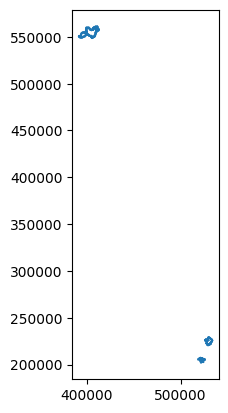

In [334]:
lsoa_2011_and_2021_shp_x_map_gdf.boundary.plot()


In [364]:
print(lsoa_2011_and_2021_shp_x_map_gdf.crs)

EPSG:27700


In [369]:
#convert to epsg=4326 (long, lat)
lsoa_2011_and_2021_shp_x_map_gdf = lsoa_2011_and_2021_shp_x_map_gdf.to_crs(epsg=4326)
#convert geometry 2021 to long lat
lsoa_2011_and_2021_shp_x_map_gdf['geometry_2021'] = lsoa_2011_and_2021_shp_x_map_gdf['geometry_2021'].to_crs(epsg=4326)

In [370]:
lsoa_2011_and_2021_shp_x_map_gdf.head()

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425..."
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541..."
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034..."
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155..."
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753..."


In [375]:

gdf_2011 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2011')
gdf_2021 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2021')

# Filter out rows with missing geometries
gdf_2011 = gdf_2011[~gdf_2011['geometry_2011'].isna()]
gdf_2021 = gdf_2021[~gdf_2021['geometry_2021'].isna()]

# Convert geometry to GeoJSON format
gdf_2011['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)


In [335]:
#see full geometry_2011 cell
pd.set_option('display.max_colwidth', None)
#reset to default
pd.reset_option('display.max_colwidth')

In [376]:
#tupe of df
type(gdf_diff)

geopandas.geodataframe.GeoDataFrame

In [381]:
lsoa_2011_and_2021_shp_x_map_gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425..."
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541..."
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034..."
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155..."
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753..."
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034..."
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753..."
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072..."
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541..."
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425..."


In [438]:
gdf = lsoa_2011_and_2021_shp_x_map_gdf.copy()

# Filter out rows with missing geometries
gdf = gdf[~gdf['geometry_2011'].isna()]
gdf = gdf[~gdf['geometry_2021'].isna()]

# Calculate the difference between the geometries
difference_geometries = []
for idx, row in gdf.iterrows():
    difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
    if not difference_geometry.is_empty:
        difference_geometries.append(difference_geometry)

# Create GeoDataFrame for the difference polygons
gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# Add the difference polygons to the original DataFrame
gdf['difference_geometry'] = gdf_difference['geometry']


In [458]:
gdf_diff

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,difference_geometry_geojson
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","{'type': 'Polygon', 'coordinates': (((-1.82359..."


In [451]:
gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794..."
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",None
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None


In [391]:
gdf.reset_index(drop=True, inplace=True)

In [392]:
gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794..."
1,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None
2,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None
3,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None
4,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None
5,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None
6,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None
7,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",None
8,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None
9,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None


In [389]:
#use lsoa_lookup to add LSOA21NM and LSOA11NM from lsoa_lookup to gdf base on LSOA11CD
gdf2 = pd.merge(gdf, lsoa_lookup[['LSOA11CD','LSOA21NM']], how='left', left_on='LSOA11CD', right_on='LSOA11CD')

In [395]:
#use lsoa_lookup to add LSOA21NM and LSOA11NM from lsoa_lookup to gdf base on LSOA11CD
gdf3 = pd.merge(gdf, lsoa_lookup[['LSOA21CD','LSOA21NM','LSOA11NM']], how='left', left_on='LSOA21CD', right_on='LSOA21CD')

In [412]:
gdf3

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,LSOA21NM,LSOA11NM
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",Northumberland 043F,Gateshead 024C
1,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",Northumberland 043F,Northumberland 039D
2,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,Gateshead 029D,Northumberland 039D
3,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,Gateshead 029D,Gateshead 024C
4,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,East Hertfordshire 002D
5,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,Stevenage 004B
6,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None,East Hertfordshire 019C,East Hertfordshire 002D
7,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,St Albans 021C,Welwyn Hatfield 014C
8,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,St Albans 021C,St Albans 015C
9,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,East Hertfordshire 002D


In [378]:
gdf_2011 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2011')
gdf_2021 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2021')

# Filter out rows with missing geometries
gdf_2011 = gdf_diff[~gdf_diff['geometry_2011'].isna()]
gdf_2021 = gdf_2021[~gdf_2021['geometry_2021'].isna()]

# Convert geometry to GeoJSON format
gdf_diff['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)


# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data to the map
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson']).add_to(map_uk)

# Add Layer Control to toggle between different layers
folium.LayerControl().add_to(map_uk)

# Display the map
map_uk

In [404]:
#Add layers for 2011 and 2021

import folium
import pandas as pd

# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data for 2011 polygons to the map
geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson']).add_to(geojson_2011_layer)
map_uk.add_child(geojson_2011_layer)

# Add GeoJSON data for 2021 polygons to the map
geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
for idx, row in gdf_2021.iterrows():
    folium.GeoJson(row['geometry_2021_geojson']).add_to(geojson_2021_layer)
map_uk.add_child(geojson_2021_layer)

# Add Layer Control to toggle between different layers
folium.LayerControl(collapsed=False).add_to(map_uk)

# Display the map
map_uk

In [424]:
#Add a layer for the difference between 2011 and 2021 polygons

# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data for 2011 polygons to the map
geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson']).add_to(geojson_2011_layer)
map_uk.add_child(geojson_2011_layer)

# Add GeoJSON data for 2021 polygons to the map
geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
for idx, row in gdf_2021.iterrows():
    folium.GeoJson(row['geometry_2021_geojson']).add_to(geojson_2021_layer)
map_uk.add_child(geojson_2021_layer)

# Calculate the difference between 2011 and 2021 polygons and add the difference layer
geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
for idx, row_2011 in gdf_2011.iterrows():
    for idx, row_2021 in gdf_2021.iterrows():
        difference_geometry = row_2011['geometry_2011'].symmetric_difference(row_2021['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geojson = difference_geometry.__geo_interface__
            folium.GeoJson(difference_geojson).add_to(geojson_difference_layer)
            break  # We only need one difference for each pair of rows
map_uk.add_child(geojson_difference_layer)

# Add Layer Control to toggle between different layers
folium.LayerControl(collapsed=False).add_to(map_uk)

# Display the map
map_uk


In [453]:
gdf_2011 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2011')
gdf_2021 = lsoa_2011_and_2021_shp_x_map_gdf.set_geometry('geometry_2021')
gdf_diff = gdf.set_geometry('difference_geometry')

# Filter out rows with missing geometries
gdf_2011 = gdf_2011[~gdf_2011['geometry_2011'].isna()]
gdf_2021 = gdf_2021[~gdf_2021['geometry_2021'].isna()]
gdf_diff = gdf_diff[~gdf_diff['difference_geometry'].isna()]

# Convert geometry to GeoJSON format
gdf_2011['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)
gdf_diff['difference_geometry_geojson'] = gdf_diff['difference_geometry'].apply(lambda x: x.__geo_interface__)

# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data for 2011 polygons to the map with labels
geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson'], 
                   name=row['LSOA11CD'], 
                   tooltip=row['LSOA11CD']).add_to(geojson_2011_layer)
map_uk.add_child(geojson_2011_layer)

# Add GeoJSON data for 2021 polygons to the map with labels
geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
for idx, row in gdf_2021.iterrows():
    folium.GeoJson(row['geometry_2021_geojson'], 
                   name=row['LSOA21CD'], 
                   tooltip=row['LSOA21CD']).add_to(geojson_2021_layer)
map_uk.add_child(geojson_2021_layer)


geojson_diff_layer = folium.FeatureGroup(name='Difference between 2011 and 2021 boundaries')
for idx, row in gdf_diff.iterrows():
    folium.GeoJson(row['difference_geometry_geojson'], 
                   name=row['LSOA21CD'], 
                   tooltip=row['LSOA21CD']).add_to(geojson_diff_layer)
map_uk.add_child(geojson_diff_layer)

# # Create GeoDataFrame for the difference polygons
# gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# # Add the difference polygons to the original DataFrame
# gdf['difference_geometry'] = gdf_difference['geometry']

# # Calculate the difference between 2011 and 2021 polygons and add the difference layer
# geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
# for idx, row_2011 in gdf_2011.iterrows():
#     for idx, row_2021 in gdf_2021.iterrows():
#         difference_geometry = row_2011['geometry_2011'].difference(row_2021['geometry_2021'])
#         if not difference_geometry.is_empty:
#             difference_geojson = difference_geometry.__geo_interface__
#             folium.GeoJson(difference_geojson, style_function=lambda x: {'fillColor': 'red'}).add_to(geojson_difference_layer)
#             break  # We only need one difference for each pair of rows

map_uk.add_child(geojson_difference_layer)

# Add Layer Control to toggle between different layers
folium.LayerControl(collapsed=False).add_to(map_uk)

# Display the map
map_uk

In [460]:
#view only polygon where there is a difference

gdf_diff = gdf_diff[~gdf_diff['difference_geometry'].isna()]

# Convert geometry to GeoJSON format
gdf_diff['geometry_2011_geojson'] = gdf_diff['geometry_2011'].apply(lambda x: x.__geo_interface__)
gdf_diff['geometry_2021_geojson'] = gdf_diff['geometry_2021'].apply(lambda x: x.__geo_interface__)
gdf_diff['difference_geometry_geojson'] = gdf_diff['difference_geometry'].apply(lambda x: x.__geo_interface__)

# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data for 2011 polygons to the map with labels
geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
for idx, row in gdf_diff.iterrows():
    folium.GeoJson(row['geometry_2011_geojson'], 
                   name=row['LSOA11CD'], 
                   tooltip=row['LSOA11CD']).add_to(geojson_2011_layer)
map_uk.add_child(geojson_2011_layer)

# Add GeoJSON data for 2021 polygons to the map with labels
geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
for idx, row in gdf_diff.iterrows():
    folium.GeoJson(row['geometry_2021_geojson'], 
                   name=row['LSOA21CD'], 
                   tooltip=row['LSOA21CD']).add_to(geojson_2021_layer)
map_uk.add_child(geojson_2021_layer)


geojson_diff_layer = folium.FeatureGroup(name='Difference between 2011 and 2021 boundaries')
for idx, row in gdf_diff.iterrows():
    folium.GeoJson(row['difference_geometry_geojson'], 
                   name=row['LSOA21CD'], 
                   tooltip=row['LSOA21CD']).add_to(geojson_diff_layer)
map_uk.add_child(geojson_diff_layer)

# # Create GeoDataFrame for the difference polygons
# gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# # Add the difference polygons to the original DataFrame
# gdf['difference_geometry'] = gdf_difference['geometry']

# # Calculate the difference between 2011 and 2021 polygons and add the difference layer
# geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
# for idx, row_2011 in gdf_2011.iterrows():
#     for idx, row_2021 in gdf_2021.iterrows():
#         difference_geometry = row_2011['geometry_2011'].difference(row_2021['geometry_2021'])
#         if not difference_geometry.is_empty:
#             difference_geojson = difference_geometry.__geo_interface__
#             folium.GeoJson(difference_geojson, style_function=lambda x: {'fillColor': 'red'}).add_to(geojson_difference_layer)
#             break  # We only need one difference for each pair of rows

map_uk.add_child(geojson_difference_layer)

# Add Layer Control to toggle between different layers
folium.LayerControl(collapsed=False).add_to(map_uk)

# Display the map
map_uk

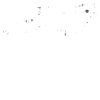

In [429]:
row_2011['geometry_2011'].difference(row_2021['geometry_2021'])

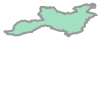

In [445]:
import pandas as pd
import geopandas as gpd

# Create a list to store difference information
difference_data = []

# Iterate over the 2011 and 2021 polygons and compute differences
for idx_2011, row_2011 in gdf_2011.iterrows():
    for idx_2021, row_2021 in gdf_2021.iterrows():
        difference_geometry = row_2011['geometry_2011'].difference(row_2021['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_data.append({
                'LSOA11CD': row_2011['LSOA11CD'],
                'LSOA21CD': row_2021['LSOA21CD'],
                'Difference_Geometry': difference_geometry,
                'geometry_2011': row_2011['geometry_2011'],  # Include geometry_2011
                'geometry_2021': row_2021['geometry_2021']   # Include geometry_2021
            })
            break  # We only need one difference for each pair of rows

# Create a DataFrame from the list of difference information
difference_df = pd.DataFrame(difference_data)

#switch columns so Difference_Geometry is last
difference_df = difference_df[['LSOA11CD','LSOA21CD','geometry_2011','geometry_2021','Difference_Geometry']]

In [448]:
difference_df

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,Difference_Geometry,difference_geometry
0,E01008187,E01035637,POLYGON ((-1.823597605036688 54.90788339673235...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-1.8235988030022416 54.9078876489911...,"POLYGON ((-1.82360 54.90789, -1.82363 54.90794..."
1,E01008187,E01035637,POLYGON ((-1.823597605036688 54.90788339673235...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-1.8235988030022416 54.9078876489911...,"MULTIPOLYGON (((-1.82686 54.90964, -1.82686 54..."
2,E01008187,E01035637,POLYGON ((-1.823597605036688 54.90788339673235...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-1.8235988030022416 54.9078876489911...,"POLYGON ((-0.11004 51.92410, -0.11012 51.92414..."
3,E01008187,E01035637,POLYGON ((-1.823597605036688 54.90788339673235...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-1.8235988030022416 54.9078876489911...,"MULTIPOLYGON (((-0.11822 51.93683, -0.11822 51..."
4,E01023508,E01035637,"POLYGON ((-0.1097327310982 51.92395320492134, ...",POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.1100386236037909 51.9241009909218...,"MULTIPOLYGON (((-0.26448 51.74451, -0.26402 51..."
5,E01023508,E01035637,"POLYGON ((-0.1097327310982 51.92395320492134, ...",POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.1100386236037909 51.9241009909218...,"MULTIPOLYGON (((-0.16398 51.91874, -0.16398 51..."
6,E01023508,E01035637,"POLYGON ((-0.1097327310982 51.92395320492134, ...",POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.1100386236037909 51.9241009909218...,"POLYGON ((-0.23839 51.74108, -0.23825 51.74106..."
7,E01023679,E01035637,POLYGON ((-0.2644849417763833 51.7445069707603...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.264482677856738 51.74450783653207...,"MULTIPOLYGON (((-0.23839 51.74108, -0.23845 51..."
8,E01023679,E01035637,POLYGON ((-0.2644849417763833 51.7445069707603...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.264482677856738 51.74450783653207...,"POLYGON ((-1.88664 54.91692, -1.88668 54.91712..."
9,E01023768,E01035637,POLYGON ((-0.1638646927442466 51.9185666077119...,POLYGON ((-1.8310673058781395 54.9443224655025...,POLYGON ((-0.1639913478190826 51.9186664426680...,"MULTIPOLYGON (((-1.89070 54.93254, -1.89070 54..."


In [447]:
# Calculate the difference between the geometries
difference_geometries = []
for idx, row in gdf.iterrows():
    difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
    if not difference_geometry.is_empty:
        difference_geometries.append(difference_geometry)

# Create GeoDataFrame for the difference polygons
gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# Add the difference polygons to the original DataFrame
difference_df['difference_geometry'] = gdf_difference['geometry']


In [433]:
gdf_2011

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,LSOA21NM,LSOA11NM,geometry_2011_geojson
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",Northumberland 043F,Gateshead 024C,"{'type': 'Polygon', 'coordinates': (((-1.82359..."
1,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",Northumberland 043F,Northumberland 039D,"{'type': 'Polygon', 'coordinates': (((-1.82359..."
2,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,Gateshead 029D,Northumberland 039D,"{'type': 'Polygon', 'coordinates': (((-1.82359..."
3,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,Gateshead 029D,Gateshead 024C,"{'type': 'Polygon', 'coordinates': (((-1.82359..."
4,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,East Hertfordshire 002D,"{'type': 'Polygon', 'coordinates': (((-0.10973..."
5,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,Stevenage 004B,"{'type': 'Polygon', 'coordinates': (((-0.10973..."
6,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None,East Hertfordshire 019C,East Hertfordshire 002D,"{'type': 'Polygon', 'coordinates': (((-0.10973..."
7,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,St Albans 021C,Welwyn Hatfield 014C,"{'type': 'Polygon', 'coordinates': (((-0.26448..."
8,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,St Albans 021C,St Albans 015C,"{'type': 'Polygon', 'coordinates': (((-0.26448..."
9,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,Stevenage 013A,East Hertfordshire 002D,"{'type': 'Polygon', 'coordinates': (((-0.16386..."


In [ ]:
# Calculate the difference between 2011 and 2021 polygons 
for idx, row_2011 in gdf_2011.iterrows():
    for idx, row_2021 in gdf_2021.iterrows():
        difference_geometry = row_2011['geometry_2011'].difference(row_2021['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geojson = difference_geometry.__geo_interface__
            folium.GeoJson(difference_geojson, style_function=lambda x: {'fillColor': 'red'}).add_to(geojson_difference_layer)
            break  # We only need one difference for each pair of rows

In [401]:
import folium
import pandas as pd
from shapely.geometry import Polygon

# Sample GeoDataFrames (replace this with your actual data)
# gdf3 is assumed to be your main GeoDataFrame containing 'geometry_2011', 'geometry_2021', and 'difference_geometry' columns

# Use set_geometry to set the geometry column
gdf_2011 = gdf3.set_geometry('geometry_2011')
gdf_2021 = gdf3.set_geometry('geometry_2021')
gdf_difference = gdf3.set_geometry('difference_geometry')

# Convert geometry to GeoJSON format
gdf_2011['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)
gdf_difference['difference_geometry_geojson'] = gdf_difference['difference_geometry'].apply(lambda x: x.__geo_interface__)

# Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Add GeoJSON data for 2011 polygons to the map
geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson']).add_to(geojson_2011_layer)
map_uk.add_child(geojson_2011_layer)

# Add GeoJSON data for 2021 polygons to the map
geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
for idx, row in gdf_2021.iterrows():
    folium.GeoJson(row['geometry_2021_geojson']).add_to(geojson_2021_layer)
map_uk.add_child(geojson_2021_layer)

# Add GeoJSON data for difference polygons to the map
geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
for idx, row in gdf_difference.iterrows():
    folium.GeoJson(row['difference_geometry_geojson']).add_to(geojson_difference_layer)
map_uk.add_child(geojson_difference_layer)

# Add Layer Control to toggle between different layers
folium.LayerControl(collapsed=False).add_to(map_uk)

# Display the map
map_uk

AttributeError: 'NoneType' object has no attribute '__geo_interface__'

In [368]:
gdf_2011

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,geometry_2011_geojson
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((410919.688 561086.691, 410927.500 56...","{'type': 'Polygon', 'coordinates': (((-1.82359..."
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((411085.468 559521.489, 410950.880 55...","{'type': 'Polygon', 'coordinates': (((-1.82359..."
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((526467.600 226268.628, 526483.873 22...","{'type': 'Polygon', 'coordinates': (((-0.10973..."
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((530763.813 228752.500, 530812.688 22...","{'type': 'Polygon', 'coordinates': (((-0.10973..."
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((521347.232 206895.797, 521350.807 20...","{'type': 'Polygon', 'coordinates': (((-0.26448..."
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((526467.600 226268.628, 526483.873 22...","{'type': 'Polygon', 'coordinates': (((-0.16386..."
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((521347.232 206895.797, 521350.807 20...","{'type': 'Polygon', 'coordinates': (((-0.23844..."
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((523621.415 206206.429, 523629.594 20...","{'type': 'Polygon', 'coordinates': (((-0.23844..."
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((411085.468 559521.489, 410950.880 55...","{'type': 'Polygon', 'coordinates': (((-1.88684..."
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((410919.688 561086.691, 410927.500 56...","{'type': 'Polygon', 'coordinates': (((-1.88684..."


In [362]:
#Create a Folium map centered on the UK
map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

# Add a UK base map (you'll need to find or provide a suitable tileset)
# For example, you can use OpenStreetMap as a generic base map
folium.TileLayer('openstreetmap').add_to(map_uk)

# Define a style function for the GeoJSON layer to make it clearer
def style_function(feature):
    return {
        'fillColor': '#ff0000',  # Fill color for the polygons
        'color': '#000000',       # Border color
        'weight': 1,              # Border width
        'fillOpacity': 0.5        # Opacity of the fill color
    }

# Add GeoJSON data to the map with the defined style function
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson'], name=row['LSOA11CD'], style_function=style_function).add_to(map_uk)

# Define the legend HTML
legend_html = '''
     <div style="position: fixed; bottom: 50px; left: 50px; z-index:9999; font-size: 14px; background-color:white; border-radius:5px; padding: 10px; border: 2px solid black;">
      &nbsp; Legend <br>
      &nbsp; E01008187 &nbsp; <i style="background: #ff0000; opacity: 0.7;"></i><br>
      &nbsp; E01008188 &nbsp; <i style="background: #0000ff; opacity: 0.7;"></i><br>
      </div>
'''

# Add the legend HTML to the map
map_uk.get_root().html.add_child(folium.Element(legend_html))

# Display the map
map_uk

In [363]:

# Create a Folium map centered on the first feature in your GeoDataFrame
map_uk = folium.Map(location=[gdf_2011['geometry_2011_geojson'][0]['coordinates'][0][0][1],
                               gdf_2011['geometry_2011_geojson'][0]['coordinates'][0][0][0]],
                     zoom_start=12,
                     tiles=None)  # No tile layer added

# Add GeoJSON data to the map
for idx, row in gdf_2011.iterrows():
    folium.GeoJson(row['geometry_2011_geojson'], name=row['LSOA11CD']).add_to(map_uk)

# Display the map
map_uk

# Final process

In [7]:
lsoa_01_to_21 = pyreadr.read_r('mye\population_LSOA11_01_to_20.rds') 

In [31]:
#set working directory
os.chdir("M:\lsoa_common")

lsoa_lookup = pd.read_csv("LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv")
lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")
lsoa_01_to_21 = pyreadr.read_r('mye\population_LSOA11_01_to_20.rds') 
#2011 shapefile
lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")

C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_7880\3988179304.py:5: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_7880\3988179304.py:6: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")


NameError: name 'pyreadr' is not defined

In [3]:
#updated function
def add_population_new_based_on_chgind(df):
    # Filter rows where CHGIND is 'S'
    filtered_df_S = df[df['CHGIND'] == 'S']
    # Group by specified columns and sum population_2021
    grouped_df_S = filtered_df_S.groupby(['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'])['population_2021'].sum().reset_index()
    # Merge the grouped data with the original DataFrame to add population_2021_new column
    merged_df_S = pd.merge(df, grouped_df_S, on=['LSOA11CD', 'sex_2021', 'age_2021', 'year_2021'], suffixes=('', '_new'), how='left')
    # Rename the population_2021_new column
    merged_df_S.rename(columns={'population_2021_new': 'population_2021_new'}, inplace=True)
    
    # Filter rows where CHGIND is 'M'
    filtered_df_M = df[df['CHGIND'] == 'M']
    #filter
    trimmed_df = filtered_df_M[['LSOA21CD','sex_2011', 'age_2011', 'year_2011', 'population_2011']]
    #drop duplicate rows
    trimmed_df_dropped = trimmed_df.drop_duplicates()
    # Group by specified columns and sum population_2011
    trimmed_df_dropped['population_2011'] = trimmed_df_dropped.groupby(['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'])['population_2011'].transform('sum')
    # Merge the grouped data with the original DataFrame to add population_2011_new column
    merged_df_M = pd.merge(merged_df_S, trimmed_df_dropped, on=['LSOA21CD', 'sex_2011', 'age_2011', 'year_2011'], suffixes=('', '_new'), how='left')
    # Rename the population_2011_new column
    merged_df_M.rename(columns={'population_2011_new': 'population_2011_new'}, inplace=True)

    return merged_df_M

In [8]:
#convert lsoa_01_to_21 to df
lsoa_01_to_21_df = lsoa_01_to_21[None]
#filter lsoa_01_to_21 by year 2011 to reduce proccessing time, remove this step when not testing
lsoa_01_to_21_2011 = lsoa_01_to_21_df[lsoa_01_to_21_df['year'] == 2011]
#lsoa_01_to_21_2011 merge with lsoa_lookup based on 'LSOA11CD'
lsoa_01_to_21_2011_and_lookup = pd.merge(lsoa_01_to_21_2011,lsoa_lookup,how='left',left_on='LSOA11CD',right_on='LSOA11CD')
#filter lsoa_01_to_22011_and_lookup 
lsoa_01_to_21_2011_and_lookup_filter = lsoa_01_to_21_2011_and_lookup[['LSOA11CD','LSOA21CD','CHGIND','sex',
 'age',
 'year',
 'population']]

In [30]:
#rename columns 'LSOA 2021 Code','LSOA 2021 Name' to 'LSOA21CD','LSOA21NM'
lsoa_2021_geog2021 = lsoa_2021_geog2021.rename(columns={'LSOA 2021 Code':'LSOA21CD','LSOA 2021 Name':'LSOA21NM'})
#merge lsoa_2021_geog2021 with lsoa_lookup based on 'LSOA21CD'
lsoa_2021_and_lookup = pd.merge(lsoa_2021_geog2021,lsoa_lookup,how='left',on='LSOA21CD')
#remve duplicates columns
lsoa_2021_and_lookup = lsoa_2021_and_lookup.loc[:,~lsoa_2021_and_lookup.columns.duplicated()]
#filter lsoa_2021_and_lookup
lsoa_2021_and_lookup_filter = lsoa_2021_and_lookup[['LSOA11CD','LSOA21CD','CHGIND','sex',
 'age',
 'year',
 'population']]

NameError: name 'lsoa_2021_geog2021' is not defined

In [10]:
lsoa_01_to_21_2011_and_lookup_filter_X = lsoa_01_to_21_2011_and_lookup_filter[(lsoa_01_to_21_2011_and_lookup_filter['CHGIND'] == 'X')] 
lsoa_2021_and_lookup_filter_X = lsoa_2021_and_lookup_filter[(lsoa_2021_and_lookup_filter['CHGIND'] == 'X')] 

### Include geometry 

In [28]:
#2011 shapefile
# lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
# lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")
#select geocode sarts with E or W
lsoa_2011_shp_ew = lsoa_2011_shp[lsoa_2011_shp['geo_code'].str[0].isin(['E','W'])]

#rename columns 'geo_code' to 'LSOA11CD'
lsoa_2011_shp_ew = lsoa_2011_shp_ew.rename(columns={'geo_code':'LSOA11CD'})

#filter LSOA21CD, geometry
lsoa_2021_shp_filter = lsoa_2021_shp[['LSOA21CD','geometry']]
lsoa_2011_shp_ew_filter = lsoa_2011_shp_ew[['LSOA11CD','geometry']]

In [29]:
#merge lsoa_2011_shp_ew_filter with lsoa_01_to_21_2011_and_lookup_filter_SM based on 'LSOA11CD'
population_2011_data = pd.merge(lsoa_01_to_21_2011_and_lookup_filter_X, lsoa_2011_shp_ew_filter, how='left',on='LSOA11CD')
lsoa_2021_shp_values_x = pd.merge(lsoa_2021_and_lookup_filter_X, lsoa_2021_shp_filter, how='left',on='LSOA21CD')

NameError: name 'lsoa_01_to_21_2011_and_lookup_filter_X' is not defined

In [13]:
#merge population_2011_dataith lsoa_2021_shp_values_x on 'LSOA21CD' and 'LSOA11CD'
lsoa_2011_and_2021_shp_x = pd.merge(lsoa_2011_shp_values_x, lsoa_2021_shp_values_x, how='left',left_on=['LSOA21CD','LSOA11CD'] ,right_on=['LSOA21CD','LSOA11CD'] )

In [14]:
#check
lsoa_2011_and_2021_shp_x['CHGIND_x'].equals(lsoa_2011_and_2021_shp_x['CHGIND_y'])

True

In [69]:
lsoa_2011_and_2021_shp_x

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,3,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,4,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
331235,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,86,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,87,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,88,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,89,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."


In [15]:
#change the string 'x' in the headings to '2011' and 'y' to '2021'
lsoa_2011_and_2021_shp_x.columns = lsoa_2011_and_2021_shp_x.columns.str.replace('_x','_2011')
lsoa_2011_and_2021_shp_x.columns = lsoa_2011_and_2021_shp_x.columns.str.replace('_y','_2021')

In [16]:
#remove colunms 'CHGIND_2021'
lsoa_2011_and_2021_shp_x = lsoa_2011_and_2021_shp_x.drop(columns=['CHGIND_2021'])
#rename columns 'CHGIND_2011' to 'CHGIND'
lsoa_2011_and_2021_shp_x = lsoa_2011_and_2021_shp_x.rename(columns={'CHGIND_2011':'CHGIND'})

In [18]:
lsoa_2011_and_2021_shp_x

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,3,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,4,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
331235,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,86,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,87,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,88,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,89,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."


In [19]:
#filter LSOA11CD, LSOA21CD, geometry_2011, geometry_2021
lsoa_2011_and_2021_shp_x_map = lsoa_2011_and_2021_shp_x[['LSOA11CD','LSOA21CD','geometry_2011','geometry_2021']]

In [29]:
#convert to geodataframe
lsoa_2011_and_2021_shp_x_map_gdf = gpd.GeoDataFrame(lsoa_2011_and_2021_shp_x_map, geometry='geometry_2011')

In [30]:
lsoa_2011_and_2021_shp_x_map_gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021
0,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,"POLYGON ((411408.391 557032.902, 411408.313 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...
331235,E01027506,E01035637,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,"POLYGON ((407351.598 558005.690, 407364.688 55...","POLYGON ((410919.688 561086.691, 410927.500 56..."


In [31]:
#convert to geodataframe
lsoa_2011_and_2021_shp_x_map_gdf = gpd.GeoDataFrame(lsoa_2011_and_2021_shp_x_map, geometry='geometry_2011')
#drop duplicate rows
lsoa_2011_and_2021_shp_x_map_gdf = lsoa_2011_and_2021_shp_x_map_gdf.drop_duplicates()
#convert to epsg=4326 (long, lat)
lsoa_2011_and_2021_shp_x_map_gdf = lsoa_2011_and_2021_shp_x_map_gdf.to_crs(epsg=4326)
#convert geometry 2021 to long lat
lsoa_2011_and_2021_shp_x_map_gdf['geometry_2021'] = lsoa_2011_and_2021_shp_x_map_gdf['geometry_2021'].to_crs(epsg=4326)

### display difference between 2011 and 2021 polygons

In [25]:
gdf = lsoa_2011_and_2021_shp_x_map_gdf.copy()

# Filter out rows with missing geometries
gdf = gdf[~gdf['geometry_2011'].isna()]
gdf = gdf[~gdf['geometry_2021'].isna()]

# Calculate the difference between the geometries
difference_geometries = []
for idx, row in gdf.iterrows():
    difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
    if not difference_geometry.is_empty:
        difference_geometries.append(difference_geometry)

# Create GeoDataFrame for the difference polygons
gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# Add the difference polygons to the original DataFrame
gdf['difference_geometry'] = gdf_difference['geometry']

NameError: name 'lsoa_2011_and_2021_shp_x_map_gdf' is not defined

In [96]:
gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,new_polygon,percentage_within_2011,percentage_within_2021
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","POLYGON ((-1.83066 54.92541, -1.82800 54.92363...",100.00000,100.000000
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,100.00000,99.967357
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None,0.00000,0.000000
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None,None,0.00000,0.000000
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None,0.00000,0.000000
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None,0.00000,0.000000
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None,0.00000,0.000000
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",None,None,0.00000,0.000000
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,99.99881,99.967357
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None,None,99.99881,100.000000


In [50]:
#datatype each column
gdf.dtypes

LSOA11CD                 object
LSOA21CD                 object
geometry_2011          geometry
geometry_2021          geometry
difference_geometry    geometry
dtype: object


### If difference is True merge the 2011 and 2021 polygons togther add to new row new polygon

In [40]:
from shapely.geometry.polygon import Polygon

In [58]:

# Function to merge polygons
def merge_polygons(row):
    if row['difference_geometry'] is not None:
        poly_2011 = row['geometry_2011']
        poly_2021 = row['geometry_2021']
        merged_polygon = poly_2011.union(poly_2021)
        return merged_polygon
    else:
        return None

# Apply the function to create the new_polygon column
gdf['new_polygon'] = gdf.apply(merge_polygons, axis=1)

In [62]:
gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,new_polygon
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","POLYGON ((-1.83066 54.92541, -1.82800 54.92363..."
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None,None
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",None,None
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None,None


In [61]:
#view allpolygons that are within the new geography
# Extract the first row of new_polygon
new_polygon_first_row = gdf['new_polygon'].iloc[0]

# Check if geometries in geometry_2011 are completely or partially within the new_polygon_first_row
completely_within_2011 = gdf['geometry_2011'].apply(lambda x: x.within(new_polygon_first_row))
partially_within_2011 = gdf['geometry_2011'].apply(lambda x: x.intersects(new_polygon_first_row))

print("Geometries in geometry_2011 completely within the new_polygon_first_row:")
print(gdf[completely_within_2011])

print("\nGeometries in geometry_2011 partially within the new_polygon_first_row:")
print(gdf[partially_within_2011])

# Check if geometries in geometry_2021 are completely or partially within the new_polygon_first_row
completely_within_2021 = gdf['geometry_2021'].apply(lambda x: x.within(new_polygon_first_row))
partially_within_2021 = gdf['geometry_2021'].apply(lambda x: x.intersects(new_polygon_first_row))

print("\nGeometries in geometry_2021 completely within the new_polygon_first_row:")
print(gdf[completely_within_2021])

print("\nGeometries in geometry_2021 partially within the new_polygon_first_row:")
print(gdf[partially_within_2021])

Geometries in geometry_2011 completely within the new_polygon_first_row:
Empty GeoDataFrame
Columns: [LSOA11CD, LSOA21CD, geometry_2011, geometry_2021, difference_geometry, new_polygon]
Index: []

Geometries in geometry_2011 partially within the new_polygon_first_row:
       LSOA11CD   LSOA21CD                                      geometry_2011  \
0     E01008187  E01035637  POLYGON ((-1.82360 54.90788, -1.82360 54.90789...   
182   E01008187  E01035624  POLYGON ((-1.82360 54.90788, -1.82360 54.90789...   
1456  E01027506  E01035624  POLYGON ((-1.88684 54.91670, -1.88664 54.91692...   
1638  E01027506  E01035637  POLYGON ((-1.88684 54.91670, -1.88664 54.91692...   

                                          geometry_2021  \
0     POLYGON ((-1.83107 54.94432, -1.83095 54.94425...   
182   POLYGON ((-1.82854 54.93025, -1.83066 54.92541...   
1456  POLYGON ((-1.82854 54.93025, -1.83066 54.92541...   
1638  POLYGON ((-1.83107 54.94432, -1.83095 54.94425...   

                             

In [65]:
#view the proportion of each polygon that is within the new geography
# Extract the first row of new_polygon
new_polygon_first_row = gdf['new_polygon'].iloc[0]

# Function to calculate percentage of polygon within new_polygon
def calculate_percentage_within(polygon, new_polygon):
    intersection_area = polygon.intersection(new_polygon).area
    polygon_area = polygon.area
    percentage_within = (intersection_area / polygon_area) * 100
    return percentage_within

# Calculate percentage of geometry_2011 within new_polygon
gdf['percentage_within_2011'] = gdf.apply(lambda row: calculate_percentage_within(row['geometry_2011'], new_polygon_first_row), axis=1)

# Calculate percentage of geometry_2021 within new_polygon
gdf['percentage_within_2021'] = gdf.apply(lambda row: calculate_percentage_within(row['geometry_2021'], new_polygon_first_row), axis=1)

       LSOA11CD   LSOA21CD                                      geometry_2011  \
0     E01008187  E01035637  POLYGON ((-1.82360 54.90788, -1.82360 54.90789...   
182   E01008187  E01035624  POLYGON ((-1.82360 54.90788, -1.82360 54.90789...   
364   E01023508  E01035582  POLYGON ((-0.10973 51.92395, -0.11004 51.92410...   
546   E01023508  E01035609  POLYGON ((-0.10973 51.92395, -0.11004 51.92410...   
728   E01023679  E01035581  POLYGON ((-0.26448 51.74451, -0.26448 51.74451...   
910   E01023768  E01035582  POLYGON ((-0.16386 51.91857, -0.16399 51.91867...   
1092  E01023964  E01035581  POLYGON ((-0.23845 51.74108, -0.23839 51.74108...   
1274  E01023964  E01035608  POLYGON ((-0.23845 51.74108, -0.23839 51.74108...   
1456  E01027506  E01035624  POLYGON ((-1.88684 54.91670, -1.88664 54.91692...   
1638  E01027506  E01035637  POLYGON ((-1.88684 54.91670, -1.88664 54.91692...   

                                          geometry_2021  \
0     POLYGON ((-1.83107 54.94432, -1.83095 54.94

In [66]:
gdf

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,new_polygon,percentage_within_2011,percentage_within_2021
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","POLYGON ((-1.83066 54.92541, -1.82800 54.92363...",100.00000,100.000000
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,100.00000,99.967357
364,E01023508,E01035582,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None,0.00000,0.000000
546,E01023508,E01035609,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",None,None,0.00000,0.000000
728,E01023679,E01035581,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None,0.00000,0.000000
910,E01023768,E01035582,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",None,None,0.00000,0.000000
1092,E01023964,E01035581,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",None,None,0.00000,0.000000
1274,E01023964,E01035608,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",None,None,0.00000,0.000000
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,99.99881,99.967357
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None,None,99.99881,100.000000


In [73]:
#filter rows where percentage_within_2011 or percentage_within_2021 are greater than 90
gdf_polygons = gdf[(gdf['percentage_within_2011'] > 90) | (gdf['percentage_within_2021'] > 90)]
#add unique LSOA11CD to list
lsoa11cd_list = gdf_polygons['LSOA11CD'].unique().tolist()
#add unique LSOA21CD to list
lsoa21cd_list = gdf_polygons['LSOA21CD'].unique().tolist()

In [76]:
gdf_polygons

,LSOA11CD,LSOA21CD,geometry_2011,geometry_2021,difference_geometry,new_polygon,percentage_within_2011,percentage_within_2021
0,E01008187,E01035637,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...","POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","POLYGON ((-1.83066 54.92541, -1.82800 54.92363...",100.00000,100.000000
182,E01008187,E01035624,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,100.00000,99.967357
1456,E01027506,E01035624,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",None,None,99.99881,99.967357
1638,E01027506,E01035637,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",None,None,99.99881,100.000000


In [74]:
#filter population by lsoa11cd_list and lsoa21cd_list
lsoa_2011_and_2021_shp_x
#filter lsoa_2011_and_2021_shp_x based on lsoa11cd_list and lsoa21cd_list
lsoa_2011_and_2021_shp_x_filter_final = lsoa_2011_and_2021_shp_x[lsoa_2011_and_2021_shp_x['LSOA11CD'].isin(lsoa11cd_list) | lsoa_2011_and_2021_shp_x['LSOA21CD'].isin(lsoa21cd_list)]

In [75]:
lsoa_2011_and_2021_shp_x_filter_final

,LSOA11CD,LSOA21CD,CHGIND,sex_2011,age_2011,year_2011,population_2011,geometry_2011,sex_2021,age_2021,year_2021,population_2021,geometry_2021
0,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,0,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
1,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,1,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
2,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,2,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
3,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,3,2021,5,"POLYGON ((410919.688 561086.691, 410927.500 56..."
4,E01008187,E01035637,X,female,0.0,2011.0,6.0,"POLYGON ((411408.391 557032.902, 411408.313 55...",female,4,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
331235,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,86,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331236,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,87,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331237,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,88,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."
331238,E01027506,E01035637,X,male,90.0,2011.0,2.0,"POLYGON ((407351.598 558005.690, 407364.688 55...",male,89,2021,0,"POLYGON ((410919.688 561086.691, 410927.500 56..."


In [91]:
# #sum pop to new geography
# lsoa_2011_shp_values_x_lsoa11_filtered = lsoa_2011_shp_values_x[lsoa_2011_shp_values_x['LSOA11CD'].isin(lsoa11cd_list)].drop(columns=['geometry','LSOA21CD']).drop_duplicates()
# lsoa_2011_shp_values_x_lsoa11_filtered_combined = lsoa_2011_shp_values_x_lsoa11_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
# # Add a new geography column called 'Xa2011'
# lsoa_2011_shp_values_x_lsoa11_filtered_combined['new_geography_2011'] = 'Xa2011'
# lsoa_2011_shp_values_x_lsoa11_filtered_combined

,CHGIND,sex,age,year,population,geography
0,X,female,0.0,2011.0,11.0,Xa2011
1,X,female,1.0,2011.0,18.0,Xa2011
2,X,female,2.0,2011.0,12.0,Xa2011
3,X,female,3.0,2011.0,19.0,Xa2011
4,X,female,4.0,2011.0,13.0,Xa2011
...,...,...,...,...,...,...
177,X,male,86.0,2011.0,4.0,Xa2011
178,X,male,87.0,2011.0,1.0,Xa2011
179,X,male,88.0,2011.0,0.0,Xa2011
180,X,male,89.0,2011.0,0.0,Xa2011


In [92]:
#sum pop to new geography 2011
lsoa_2011_shp_values_x_lsoa11_filtered = lsoa_2011_shp_values_x[lsoa_2011_shp_values_x['LSOA11CD'].isin(lsoa11cd_list)].drop(columns=['geometry','LSOA21CD']).drop_duplicates()
lsoa_2011_shp_values_x_lsoa11_filtered_combined = lsoa_2011_shp_values_x_lsoa11_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
# Add a new geography column called 'Xa2011'
lsoa_2011_shp_values_x_lsoa11_filtered_combined['new_geography_2011'] = 'LSOAx_2011'
lsoa_2011_shp_values_x_lsoa11_filtered_combined

,CHGIND,sex,age,year,population,new_geography_2011
0,X,female,0.0,2011.0,11.0,Xa2011
1,X,female,1.0,2011.0,18.0,Xa2011
2,X,female,2.0,2011.0,12.0,Xa2011
3,X,female,3.0,2011.0,19.0,Xa2011
4,X,female,4.0,2011.0,13.0,Xa2011
...,...,...,...,...,...,...
177,X,male,86.0,2011.0,4.0,Xa2011
178,X,male,87.0,2011.0,1.0,Xa2011
179,X,male,88.0,2011.0,0.0,Xa2011
180,X,male,89.0,2011.0,0.0,Xa2011


In [93]:
#sum pop to new geography 2021
soa_2021_shp_values_x_lsoa21_filtered = lsoa_2021_shp_values_x[lsoa_2021_shp_values_x['LSOA21CD'].isin(lsoa21cd_list)].drop(columns=['geometry','LSOA11CD']).drop_duplicates()
lsoa_2021_shp_values_x_lsoa21_filtered_combined = lsoa_2021_shp_values_x_lsoa21_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
# Add a new geography column called 'Xa2021'
lsoa_2021_shp_values_x_lsoa21_filtered_combined['new_geography_2021'] = 'LSOAx_2021'
lsoa_2021_shp_values_x_lsoa21_filtered_combined

,CHGIND,sex,age,year,population,new_geography_2021
0,X,female,0,2021,5,Xa2021
1,X,female,1,2021,10,Xa2021
2,X,female,2,2021,10,Xa2021
3,X,female,3,2021,10,Xa2021
4,X,female,4,2021,0,Xa2021
...,...,...,...,...,...,...
177,X,male,86,2021,0,Xa2021
178,X,male,87,2021,0,Xa2021
179,X,male,88,2021,0,Xa2021
180,X,male,89,2021,6,Xa2021


### Verify that this also works with MSOA lookups

In [3]:
os.chdir("M:\lsoa_common")

lsoa_lookup = pd.read_csv("LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv")
lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")
lsoa_01_to_21 = pyreadr.read_r('mye\population_LSOA11_01_to_20.rds') 
#2011 shapefile
lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")

C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_25232\3238273254.py:4: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2021_geog2021 = pd.read_csv("mye\population_LSOA21_21.csv")
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_25232\3238273254.py:5: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  lsoa_2022_geog2021 = pd.read_csv("mye\population_LSOA21_22.csv")


In [3]:
#repeat for msoa
os.chdir("M:\lsoa_common")

msoa_lookup = pd.read_csv("MSOA_(2011)_to_MSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales.csv")
#shape files
msoa_2011_shp = gpd.read_file("infuse_msoa_lyr_2011_clipped\infuse_msoa_lyr_2011_clipped.shp")
msoa_2021_shp = gpd.read_file("MOSA_2021_EW_BFC_V6_6000765062319633493\MSOA_2021_EW_BFC_V6.shp")



In [108]:
#rename geo_code to MSOA11CD
msoa_2011_shp = msoa_2011_shp.rename(columns={'geo_code':'MSOA11CD'})
#filter geometry and msoa11cd
msoa_2011_shp_filter = msoa_2011_shp[['MSOA11CD','geometry']]
#filer msoa_2021_shp based on 'MSOA21CD'. 'geometry'
msoa_2021_shp_filter = msoa_2021_shp[['MSOA21CD','geometry']]


In [102]:
msoa_lookup

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId
0,E02000001,City of London 001,U,E02000001,City of London 001,E09000001,City of London,NaN,1
1,E02000002,Barking and Dagenham 001,U,E02000002,Barking and Dagenham 001,E09000002,Barking and Dagenham,NaN,2
2,E02000003,Barking and Dagenham 002,U,E02000003,Barking and Dagenham 002,E09000002,Barking and Dagenham,NaN,3
3,E02000004,Barking and Dagenham 003,U,E02000004,Barking and Dagenham 003,E09000002,Barking and Dagenham,NaN,4
4,E02000005,Barking and Dagenham 004,U,E02000005,Barking and Dagenham 004,E09000002,Barking and Dagenham,NaN,5
...,...,...,...,...,...,...,...,...,...
7281,W02000086,Wrexham 009,M,W02000426,Wrexham 023,W06000006,Wrexham,Wrecsam,7282
7282,W02000203,Neath Port Talbot 005,M,W02000427,Neath Port Talbot 021,W06000012,Neath Port Talbot,Castell-nedd Port Talbot,7283
7283,W02000209,Neath Port Talbot 011,M,W02000427,Neath Port Talbot 021,W06000012,Neath Port Talbot,Castell-nedd Port Talbot,7284
7284,W02000187,Swansea 020,M,W02000428,Swansea 032,W06000011,Swansea,Abertawe,7285


In [104]:
#unique chgind
print(msoa_lookup['CHNGIND'].unique())
#select X
msoa_lookup_X = msoa_lookup[msoa_lookup['CHNGIND'] == 'X']

['U' 'S' 'M' 'X']


In [112]:
msoa_2011_shp_values_x

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((415155.428 557867.628, 415155.984 55..."
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((400978.596 562838.500, 400979.237 56..."
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((518049.463 207224.664, 518050.783 20..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((522260.947 206377.667, 522255.329 20..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((527143.229 226938.415, 527149.188 22..."
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((525893.984 225709.670, 525902.608 22..."
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((522260.947 206377.667, 522255.329 20..."
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((527143.229 226938.415, 527149.188 22..."
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((415155.428 557867.628, 415155.984 55..."


In [114]:
#select X
msoa_lookup_X = msoa_lookup[msoa_lookup['CHNGIND'] == 'X']
#merge msoa_lookup_X with msoa_2011_shp_filter based on 'MSOA11CD'
msoa_2011_shp_values_x = pd.merge(msoa_lookup_X, msoa_2011_shp_filter, how='left',on='MSOA11CD')
#rename geometry to geometry_2011
msoa_2011_shp_values_x = msoa_2011_shp_values_x.rename(columns={'geometry':'geometry_2011'})
#merge msoa_2011_shp_values_x with msoa_2021_shp_filter based on 'MSOA21CD'
msoa_shp_values_x = pd.merge(msoa_2011_shp_values_x, msoa_2021_shp_filter, how='left',on='MSOA21CD')
#rename geometry to geometry_2021
msoa_shp_values_x = msoa_shp_values_x.rename(columns={'geometry':'geometry_2021'})

gdf = msoa_shp_values_x.copy()

# Filter out rows with missing geometries
gdf = gdf[~gdf['geometry_2011'].isna()]
gdf = gdf[~gdf['geometry_2021'].isna()]

# Calculate the difference between the geometries
difference_geometries = []
for idx, row in gdf.iterrows():
    difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
    if not difference_geometry.is_empty:
        difference_geometries.append(difference_geometry)

# Create GeoDataFrame for the difference polygons
gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

# Add the difference polygons to the original DataFrame
gdf['difference_geometry'] = gdf_difference['geometry']


In [115]:
msoa_shp_values_x

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((415155.428 557867.628, 415155.984 55...","POLYGON ((399543.688 570296.375, 399550.009 57..."
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((400978.596 562838.500, 400979.237 56...","POLYGON ((399543.688 570296.375, 399550.009 57..."
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((518049.463 207224.664, 518050.783 20...","POLYGON ((519819.351 208913.975, 519885.202 20..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((522260.947 206377.667, 522255.329 20...","POLYGON ((519819.351 208913.975, 519885.202 20..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((527143.229 226938.415, 527149.188 22...","POLYGON ((526467.600 226268.628, 526483.873 22..."
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((525893.984 225709.670, 525902.608 22...","POLYGON ((526467.600 226268.628, 526483.873 22..."
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((522260.947 206377.667, 522255.329 20...","POLYGON ((522775.491 206879.447, 522776.905 20..."
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((527143.229 226938.415, 527149.188 22...","POLYGON ((532715.188 231520.703, 532721.875 23..."
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((415155.428 557867.628, 415155.984 55...","POLYGON ((410847.406 562083.812, 410854.556 56..."


In [116]:
def calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup):
    # Select 'X' from lookup
    lookup_X = lookup[lookup['CHNGIND'] == 'X']
    
    # Merge lookup_X with shapefile_2011 based on 'CD_2011'
    values_2011_x = pd.merge(lookup_X, shapefile_2011, how='left', on='CD_2011')
    # Rename geometry to geometry_2011
    values_2011_x = values_2011_x.rename(columns={'geometry':'geometry_2011'})
    
    # Merge values_2011_x with shapefile_2021 based on 'CD_2021'
    values_x = pd.merge(values_2011_x, shapefile_2021, how='left', on='CD_2021')
    # Rename geometry to geometry_2021
    values_x = values_x.rename(columns={'geometry':'geometry_2021'})
    
    gdf = values_x.copy()

    # Filter out rows with missing geometries
    gdf = gdf[~gdf['geometry_2011'].isna()]
    gdf = gdf[~gdf['geometry_2021'].isna()]

    # Calculate the difference between the geometries
    difference_geometries = []
    for idx, row in gdf.iterrows():
        difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geometries.append(difference_geometry)

    # Create GeoDataFrame for the difference polygons
    gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

    # Add the difference polygons to the original DataFrame
    gdf['difference_geometry'] = gdf_difference['geometry']
    
    return gdf

In [129]:
import pandas as pd
import geopandas as gpd

def calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, area_code):
    # Select 'X' from lookup
    lookup_X = lookup[lookup['CHNGIND'] == 'X']
    
    # Determine the appropriate area code suffix based on the input area_code
    code_suffix_2011 = area_code + '11CD'
    code_suffix_2021 = area_code + '21CD'
    
    # Merge lookup_X with shapefile_2011 based on the area code
    values_2011_x = pd.merge(lookup_X, shapefile_2011, how='left', left_on=code_suffix_2011, right_on=code_suffix_2011)
    # Rename geometry to geometry_2011
    values_2011_x = values_2011_x.rename(columns={'geometry':'geometry_2011'})

    # Merge values_2011_x with shapefile_2021 based on the area code
    values_x = pd.merge(values_2011_x, shapefile_2021, how='left', left_on=code_suffix_2021, right_on=code_suffix_2021)
    # Rename geometry to geometry_2021
    values_x = values_x.rename(columns={'geometry':'geometry_2021'})

    #convert values_x to geodataframe crs(epsg=4326)
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2021')
    values_x = values_x.to_crs(epsg=4326)
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2011')
    values_x = values_x.to_crs(epsg=4326)
    
    gdf = values_x.copy()

    # Filter out rows with missing geometries
    gdf = gdf[~gdf['geometry_2011'].isna()]
    gdf = gdf[~gdf['geometry_2021'].isna()]

    # Calculate the difference between the geometries
    difference_geometries = []
    for idx, row in gdf.iterrows():
        difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geometries.append(difference_geometry)

    # Create GeoDataFrame for the difference polygons
    gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)

    # Add the difference polygons to the original DataFrame
    gdf['difference_geometry'] = gdf_difference['geometry']
    
    return gdf

# Usage example:
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'MSOA')
# Or
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'LSOA')
# Or
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'CustomCode')


In [5]:
import pandas as pd
import geopandas as gpd

def calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, area_code):
    """
    Calculate the geometry differences between two shapefiles rbetween 2011 and 2021.

    This function merges 2011 and 2021 shapefiles, calculates the difference in geometry between corresponding features, and removes features with over 99% overlap,
    as these are not signicantly different.

    Parameters:
    - shapefile_2011 (GeoDataFrame): A GeoDataFrame containing geometries for the first time period, 2011.
    - shapefile_2021 (GeoDataFrame): A GeoDataFrame containing geometries for the second time period, 2021
    - lookup (DataFrame): A DataFrame containing lookup information for the slected boundary
    - area_code (str): A string indicating the area code to use for merging and lookup (e.i. LSOA or MSOA)

    Returns:
    GeoDataFrame: A GeoDataFrame containing the geometry differences between the two time periods.
    """
    # Select 'X' from lookup
    lookup_X = lookup[lookup['CHNGIND'] == 'X']
    
    # Determine the appropriate area code suffix based on the input area_code
    code_suffix_2011 = area_code + '11CD'
    code_suffix_2021 = area_code + '21CD'
    
    # Merge lookup_X with shapefile_2011 based on the area code
    values_2011_x = pd.merge(lookup_X, shapefile_2011, how='left', left_on=code_suffix_2011, right_on=code_suffix_2011)
    # Rename geometry to geometry_2011
    values_2011_x = values_2011_x.rename(columns={'geometry':'geometry_2011'})

    # Merge values_2011_x with shapefile_2021 based on the area code
    values_x = pd.merge(values_2011_x, shapefile_2021, how='left', left_on=code_suffix_2021, right_on=code_suffix_2021)
    # Rename geometry to geometry_2021
    values_x = values_x.rename(columns={'geometry':'geometry_2021'})

    # Convert values_x to GeoDataFrame and reproject to EPSG:4326
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2021')
    values_x = values_x.to_crs(epsg=4326)
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2011')
    values_x = values_x.to_crs(epsg=4326)
    
    gdf = values_x.copy()

    # Filter out rows with missing geometries
    gdf = gdf[~gdf['geometry_2011'].isna()]
    gdf = gdf[~gdf['geometry_2021'].isna()]

    # Calculate the difference between the geometries
    difference_geometries = []
    percent_overlap = []
    for idx, row in gdf.iterrows():
        difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geometries.append(difference_geometry)
            overlap_area = row['geometry_2011'].intersection(row['geometry_2021']).area
            percent_overlap.append(overlap_area / row['geometry_2011'].area * 100)
        else:
            percent_overlap.append(0)  # If no difference, then 100% overlap
    
    # Create GeoDataFrame for the difference polygons
    gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)
    gdf['percent_overlap'] = percent_overlap

    #if percent_overlap is greater than 99 remove from df
    gdf = gdf[gdf['percent_overlap'] <= 99]


    # Add the difference polygons to the original DataFrame
    gdf['difference_geometry'] = gdf_difference['geometry']
    
    return gdf

# Usage example:
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'MSOA')
# Or
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'LSOA')
# Or
# result_gdf = calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, 'CustomCode')

In [52]:

def calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, area_code):
    """
    Calculate the geometry differences between two shapefiles between 2011 and 2021.

    This function merges 2011 and 2021 shapefiles, calculates the difference in geometry between corresponding features, and removes features with over 99% overlap,
    as these are not significantly different.

    Parameters:
    - shapefile_2011 (GeoDataFrame): A GeoDataFrame containing geometries for the first time period, 2011.
    - shapefile_2021 (GeoDataFrame): A GeoDataFrame containing geometries for the second time period, 2021
    - lookup (DataFrame): A DataFrame containing lookup information for the selected boundary
    - area_code (str): A string indicating the area code to use for merging and lookup (e.g., LSOA or MSOA)

    Returns:
    GeoDataFrame: A GeoDataFrame containing the geometry differences between the two time periods.
    """
    # Rename geo_code to area code 11CD
    shapefile_2011 = shapefile_2011.rename(columns={'geo_code': area_code + '11CD'})

    # Filter geometry and area code 11CD
    shapefile_2011_filter = shapefile_2011[[area_code + '11CD', 'geometry']]

    # Filter shapefile_2021 based on 'area code 21CD' and 'geometry'
    shapefile_2021_filter = shapefile_2021[[area_code + '21CD', 'geometry']]

    # Select 'X' from lookup
    lookup_X = lookup[lookup['CHNGIND'] == 'X']
    
    # Determine the appropriate area code suffix based on the input area_code
    code_suffix_2011 = area_code + '11CD'
    code_suffix_2021 = area_code + '21CD'
    
    # Merge lookup_X with shapefile_2011 based on the area code
    values_2011_x = pd.merge(lookup_X, shapefile_2011_filter, how='left', left_on=code_suffix_2011, right_on=area_code + '11CD')
    # Rename geometry to geometry_2011
    values_2011_x = values_2011_x.rename(columns={'geometry':'geometry_2011'})

    # Merge values_2011_x with shapefile_2021 based on the area code
    values_x = pd.merge(values_2011_x, shapefile_2021_filter, how='left', left_on=code_suffix_2021, right_on=area_code + '21CD')
    # Rename geometry to geometry_2021
    values_x = values_x.rename(columns={'geometry':'geometry_2021'})

    # Convert values_x to GeoDataFrame and reproject to EPSG:4326
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2021')
    values_x = values_x.to_crs(epsg=4326)
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2011')
    values_x = values_x.to_crs(epsg=4326)
    
    gdf = values_x.copy()

    # Filter out rows with missing geometries
    gdf = gdf[~gdf['geometry_2011'].isna()]
    gdf = gdf[~gdf['geometry_2021'].isna()]

    # Calculate the difference between the geometries
    difference_geometries = []
    percent_overlap = []
    for idx, row in gdf.iterrows():
        difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geometries.append(difference_geometry)
            overlap_area = row['geometry_2011'].intersection(row['geometry_2021']).area
            percent_overlap.append(overlap_area / row['geometry_2011'].area * 100)
        else:
            percent_overlap.append(0)  # If no difference, then 100% overlap
    
    # Create GeoDataFrame for the difference polygons
    gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)
    gdf['percent_overlap'] = percent_overlap

    #if percent_overlap is greater than 99 remove from df
    gdf_mapping = gdf[gdf['percent_overlap'] <= 99]

    # Add the difference polygons to the original DataFrame
    gdf['difference_geometry'] = gdf_difference['geometry']
    
    return gdf, gdf_mapping

# Usage example:
# result_gdf = calculate_geometry_differences(msoa_2011_shp, msoa_2021_shp, lookup, 'MSOA')

In [53]:
msoa_gdf, msoa_mapping = calculate_geometry_differences(msoa_2011_shp, msoa_2021_shp, msoa_lookup, 'MSOA')

In [54]:
msoa_gdf

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977,"POLYGON ((-1.76511 54.91525, -1.76503 54.91496..."
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((-1.98625 54.96018, -1.98624 54.96015...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",99.999299,"MULTIPOLYGON (((-1.98266 54.95496, -1.98189 54..."
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((-0.29128 51.75129, -0.29126 51.75138...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",99.994010,"MULTIPOLYGON (((-0.29149 51.75142, -0.29149 51..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582,"POLYGON ((-0.23068 51.74287, -0.23069 51.74288..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825,"POLYGON ((-0.15229 51.92648, -0.15242 51.92668..."
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((-0.17099 51.91569, -0.17086 51.91569...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999880,"MULTIPOLYGON (((-0.17049 51.91569, -0.17048 51..."
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.22298 51.74717, -0.22296 51.74713...",99.950377,"MULTIPOLYGON (((-0.23013 51.74372, -0.23006 51..."
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.06963 51.96633, -0.06954 51.96612...",99.984158,"MULTIPOLYGON (((-0.15138 51.93104, -0.15138 51..."
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-1.83216 54.95328, -1.83205 54.95318...",99.989993,"MULTIPOLYGON (((-1.76620 54.90926, -1.76620 54..."


In [55]:
msoa_mapping

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825


In [26]:
msoa_mapping

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825


In [ ]:
import pandas as pd
import geopandas as gpd

def merge_and_filter_polygons(gdf, msoa_mapping):
    """
    Merge polygons from 2011 to 2021 and filter out polygons with high overlap percentages.

    Parameters:
    - gdf (GeoDataFrame): A GeoDataFrame containing geometries for both 2011 and 2021.
    - msoa_mapping (DataFrame): A DataFrame containing mapping between MSOA11CD and MSOA21CD.

    Returns:
    - tuple: A tuple containing two lists, one for MSOA11CD and one for MSOA21CD, after filtering.
    """
   
        poly_2011 = msoa_mapping['geometry_2011']
        poly_2021 = msoa_mapping['geometry_2021']
        merged_polygon = poly_2011.union(poly_2021)
       
    
    # Make a new column called 'new_polygon' in the dataframe
    msoa_mapping['new_polygon'] = gdf.apply(merge_polygons, axis=1)
    
   n
    dcalculate_percentage_within(polygon, new_polygon):
        intersection_area = polygon.intersection(msoa_mapping['new_polygon']n).area
        polygon_area = polygon.area
        percentage_within = (intersection_area / polygon_area) * 100
        return percentage_within

    # Calculate percentage of geometry_2011 within new_polygon
    gdf['percentage_within_2011'] = gdf['geometry_2011'].apply(lambda polygon: calculate_percentage_within(polygon, new_polygon_first_row))

    # Calculate percentage of geometry_2021 within new_polygon
    gdf['percentage_within_2021'] = gdf['geometry_2021'].apply(lambda polygon: calculate_percentage_within(polygon, new_polygon_first_row))
    
    # Filter rows where percentage_within_2011 or percentage_within_2021 are greater than 90
    gdf_polygons = gdf[(gdf['percentage_within_2011'] > 90) | (gdf['percentage_within_2021'] > 90)]
    
    # Add unique MSOA11CD to list
    msoa11cd_list = gdf_polygons['MSOA11CD'].unique().tolist()
    # Add unique MSOA21CD to list
    msoa21cd_list = gdf_polygons['MSOA21CD'].unique().tolist()
    
    return msoa11cd_list, msoa21cd_list

# Usage example:
# msoa11cd_list, msoa21cd_list = merge_and_filter_polygons(gdf, msoa_mapping)

In [ ]:
import pandas as pd
from shapely.geometry import Polygon

def calculate_overlap_percentage(msoa_mapping, msoa_gdf):
    poly_2011 = msoa_mapping['geometry_2011']
    poly_2021 = msoa_mapping['geometry_2021']
    merged_polygon = poly_2011.union(poly_2021)
    msoa_mapping['new_polygon'] = merged_polygon

    def calculate_overlap(row):
        poly_2011 = row['geometry_2011']
        poly_2021 = row['geometry_2021']
        overlap_percentage_2011 = poly_2011.intersection(merged_polygon).area / poly_2011.area * 100
        overlap_percentage_2021 = poly_2021.intersection(merged_polygon).area / poly_2021.area * 100
        return pd.Series({'overlap_percentage_2011': overlap_percentage_2011,
                          'overlap_percentage_2021': overlap_percentage_2021})

    msoa_gdf[['overlap_percentage_2011', 'overlap_percentage_2021']] = msoa_gdf.apply(calculate_overlap, axis=1)

    return msoa_mapping, msoa_gdf

# Example usage:
# msoa_mapping and msoa_gdf are your input dataframes
# msoa_mapping, msoa_gdf = calculate_overlap_percentage(msoa_mapping, msoa_gdf)


#an addtion varification step to insure there are no other polygons that fit within the newly created polygons as their populations will have to be combined as well

In [46]:
merge_geo = msoa_mapping.copy()
poly_2011 = merge_geo['geometry_2011']
poly_2021 = merge_geo['geometry_2021']
merged_polygon = poly_2011.union(poly_2021)
merge_geo['new_polygon'] = merged_polygon

In [50]:
merge_geo 

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,new_polygon
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977,"POLYGON ((-1.76511 54.91525, -1.76503 54.91496..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582,"POLYGON ((-0.23068 51.74287, -0.23069 51.74288..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825,"POLYGON ((-0.15229 51.92648, -0.15242 51.92668..."


In [47]:
gdf2 = msoa_gdf.copy()

In [48]:
import geopandas as gpd
import numpy as np
from tqdm import tqdm  # For progress bar

# Initialize empty list to store overlap percentages for each polygon in merge_geo['new_polygon']
overlap_columns = []

# Loop through each polygon in merge_geo['new_polygon']
for idx, new_polygon in tqdm(enumerate(merge_geo['new_polygon']), desc="Calculating overlap"):
    # Perform spatial overlay to find intersection between gdf2 and the current new_polygon
    intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
    intersection_2021 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
    
    # Calculate area of each intersection
    intersection_2011['intersection_area'] = intersection_2011.geometry.area
    intersection_2021['intersection_area'] = intersection_2021.geometry.area
    
    # Calculate area of each polygon in gdf2
    gdf2['polygon_area_2011'] = gdf2.geometry_2011.area
    gdf2['polygon_area_2021'] = gdf2.geometry_2021.area
    
    # Calculate percentage overlap, ensuring it doesn't exceed 100%
    overlap_percentage_2011 = np.minimum(intersection_2011['intersection_area'] / gdf2['polygon_area_2011'] * 100, 100)
    overlap_percentage_2021 = np.minimum(intersection_2021['intersection_area'] / gdf2['polygon_area_2021'] * 100, 100)
    
    # Add overlap percentage columns to overlap_columns list
    overlap_columns.append(overlap_percentage_2011)
    overlap_columns.append(overlap_percentage_2021)

# Concatenate the overlap_columns list to create a DataFrame with overlap percentages for each polygon
overlap_df = pd.concat(overlap_columns, axis=1)

# Rename columns with meaningful names
column_names = [f'overlap_percentage_polygon_{idx}_2011' for idx in range(len(merge_geo['new_polygon']))] + \
               [f'overlap_percentage_polygon_{idx}_2021' for idx in range(len(merge_geo['new_polygon']))]
overlap_df.columns = column_names

# Concatenate overlap_df with gdf2
gdf2_with_overlap = pd.concat([gdf2, overlap_df], axis=1)

gdf2_with_overlap = pd.concat([gdf2, overlap_df], axis=1)

Calculating overlap: 0it [00:00, ?it/s]C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\2991007354.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\2991007354.py:11: UserWarning: `keep_geom_type=True` in overlay resulted in 1 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\2991007354.py:12: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the i

In [51]:
gdf2_with_overlap



,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,...,percent_overlap,difference_geometry,polygon_area_2011,polygon_area_2021,overlap_percentage_polygon_0_2011,overlap_percentage_polygon_1_2011,overlap_percentage_polygon_2_2011,overlap_percentage_polygon_0_2021,overlap_percentage_polygon_1_2021,overlap_percentage_polygon_2_2021
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...",...,0.009977,"POLYGON ((-1.76511 54.91525, -1.76503 54.91496...",0.002686,0.026153,100.000000,10.269198,54.231167,5.569106,100.00000,49.105946
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((-1.98625 54.96018, -1.98624 54.96015...",...,99.999299,"MULTIPOLYGON (((-1.98266 54.95496, -1.98189 54...",0.026153,0.026153,99.999299,99.998964,5.627090,5.627071,0.63813,0.638128
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((-0.29128 51.75129, -0.29126 51.75138...",...,99.994010,"MULTIPOLYGON (((-0.29149 51.75142, -0.29149 51...",0.001457,0.001457,100.000000,100.000000,100.000000,100.000000,100.00000,100.000000
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...",...,0.049582,"POLYGON ((-0.23068 51.74287, -0.23069 51.74288...",0.001472,0.001457,NaN,NaN,NaN,NaN,NaN,NaN
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...",...,0.015825,"POLYGON ((-0.15229 51.92648, -0.15242 51.92668...",0.012843,0.000169,NaN,NaN,NaN,NaN,NaN,NaN
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((-0.17099 51.91569, -0.17086 51.91569...",...,99.999880,"MULTIPOLYGON (((-0.17049 51.91569, -0.17048 51...",0.000167,0.000169,NaN,NaN,NaN,NaN,NaN,NaN
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...",...,99.950377,"MULTIPOLYGON (((-0.23013 51.74372, -0.23006 51...",0.001472,0.001471,NaN,NaN,NaN,NaN,NaN,NaN
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...",...,99.984158,"MULTIPOLYGON (((-0.15138 51.93104, -0.15138 51...",0.012843,0.012841,NaN,NaN,NaN,NaN,NaN,NaN
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...",...,99.989993,"MULTIPOLYGON (((-1.76620 54.90926, -1.76620 54...",0.002686,0.002686,NaN,NaN,NaN,NaN,NaN,NaN


In [61]:
#now filter the population data by the area code lists as these will be the population we need to combine to to go from 2011 2021
population_data_11_and_21_filter_final = population_data_11_and_21[lsoa_2011_and_2021_shp_x['MSOA11CD'].isin(msoa11cd_list) | population_data_11_and_21['MSOA21CD'].isin(msoa21cd_list)] 
#sum pop to new geography 2011
population_2011_data_lsoa11_filtered = population_2011_data[lpopulation_2011_data['MSOA11CD'].isin(lsoa11cd_list)].drop(columns=['geometry','MSOA21CD']).drop_duplicates()
population_2011_data_filtered_combined = lsoa_2011_shp_values_x_lsoa11_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
# Add a new geography column called 'Xa2011'
lsoa_2011_shp_values_x_lsoa11_filtered_combined['new_geography_2011'] = 'MSOAx_2011'
lsoa_2011_shp_values_x_lsoa11_filtered_combined

#sum pop to new geography 2021
soa_2021_shp_values_x_lsoa21_filtered = lsoa_2021_shp_values_x[lsoa_2021_shp_values_x['LSOA21CD'].isin(lsoa21cd_list)].drop(columns=['geometry','LSOA11CD']).drop_duplicates()
lsoa_2021_shp_values_x_lsoa21_filtered_combined = lsoa_2021_shp_values_x_lsoa21_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
# Add a new geography column called 'Xa2021'
lsoa_2021_shp_values_x_lsoa21_filtered_combined['new_geography_2021'] = 'LSOAx_2021'
lsoa_2021_shp_values_x_lsoa21_filtered_combined

['E02001705', 'E02005732', 'E02004938']

In [57]:
 msoa_gdf

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977,"POLYGON ((-1.76511 54.91525, -1.76503 54.91496..."
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((-1.98625 54.96018, -1.98624 54.96015...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",99.999299,"MULTIPOLYGON (((-1.98266 54.95496, -1.98189 54..."
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((-0.29128 51.75129, -0.29126 51.75138...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",99.994010,"MULTIPOLYGON (((-0.29149 51.75142, -0.29149 51..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582,"POLYGON ((-0.23068 51.74287, -0.23069 51.74288..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825,"POLYGON ((-0.15229 51.92648, -0.15242 51.92668..."
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((-0.17099 51.91569, -0.17086 51.91569...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999880,"MULTIPOLYGON (((-0.17049 51.91569, -0.17048 51..."
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.22298 51.74717, -0.22296 51.74713...",99.950377,"MULTIPOLYGON (((-0.23013 51.74372, -0.23006 51..."
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.06963 51.96633, -0.06954 51.96612...",99.984158,"MULTIPOLYGON (((-0.15138 51.93104, -0.15138 51..."
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-1.83216 54.95328, -1.83205 54.95318...",99.989993,"MULTIPOLYGON (((-1.76620 54.90926, -1.76620 54..."


In [ ]:
# Function to merge polygons 2011 to 2021
#from dtatframe msoa_mapping
def merge_polygons(row):
        poly_2011 = row['geometry_2011']
        poly_2021 = row['geometry_2021']
        merged_polygon = poly_2011.union(poly_2021)
        return merged_polygon
#make a new column called in the dataframe
gdf['new_polygon'] = gdf.apply(merge_polygons, axis=1)

#then with a second dataframe dataframe see whther any of geometry_2011 or geometry_2021 fit in the gdf['new_polygon'], like intersect of overlapp



# Function to calculate percentage of polygon within new_polygon
def calculate_percentage_within(polygon, new_polygon):
    intersection_area = polygon.intersection(new_polygon).area
    polygon_area = polygon.area
    percentage_within = (intersection_area / polygon_area) * 100
    return percentage_within

# Calculate percentage of geometry_2011 within new_polygon
gdf['percentage_within_2011'] = gdf.apply(lambda row: calculate_percentage_within(row['geometry_2011'], new_polygon_first_row), axis=1)

# Calculate percentage of geometry_2021 within new_polygon

gdf['percentage_within_2021'] = gdf.apply(lambda row: calculate_percentage_within(row['geometry_2021'], new_polygon_first_row), axis=1)
#filter rows where percentage_within_2011 or percentage_within_2021 are greater than 90
gdf_polygons = gdf[(gdf['percentage_within_2011'] > 90) | (gdf['percentage_within_2021'] > 90)]






In [ ]:
import geopandas as gpd
import numpy as np
from tqdm import tqdm  # For progress bar

# Initialize empty list to store overlap percentages for each polygon in merge_geo['new_polygon']
overlap_columns = []

# Loop through each polygon in merge_geo['new_polygon']
for idx, new_polygon in tqdm(enumerate(merge_geo['new_polygon']), desc="Calculating overlap"):
    # Perform spatial overlay to find intersection between gdf2 and the current new_polygon
    intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
    intersection_2021 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
    
    # Calculate area of each intersection
    intersection_2011['intersection_area'] = intersection_2011.geometry.area
    intersection_2021['intersection_area'] = intersection_2021.geometry.area
    
    # Calculate area of each polygon in gdf2
    gdf2['polygon_area_2011'] = gdf2.geometry_2011.area
    gdf2['polygon_area_2021'] = gdf2.geometry_2021.area
    
    # Calculate percentage overlap, ensuring it doesn't exceed 100%
    overlap_percentage_2011 = np.minimum(intersection_2011['intersection_area'] / gdf2['polygon_area_2011'] * 100, 100)
    overlap_percentage_2021 = np.minimum(intersection_2021['intersection_area'] / gdf2['polygon_area_2021'] * 100, 100)
    
    # Add overlap percentage columns to overlap_columns list
    overlap_columns.append(overlap_percentage_2011)
    overlap_columns.append(overlap_percentage_2021)

# Concatenate the overlap_columns list to create a DataFrame with overlap percentages for each polygon
overlap_df = pd.concat(overlap_columns, axis=1)

# Rename columns with meaningful names
column_names = [f'overlap_percentage_polygon_{idx}_2011' for idx in range(len(merge_geo['new_polygon']))] + \
               [f'overlap_percentage_polygon_{idx}_2021' for idx in range(len(merge_geo['new_polygon']))]
overlap_df.columns = column_names

# Concatenate overlap_df with gdf2
gdf2_with_overlap = pd.concat([gdf2, overlap_df], axis=1)

gdf2_with_overlap = pd.concat([gdf2, overlap_df], axis=1)


In [89]:
import geopandas as gpd
import numpy as np
import pandas as pd
from tqdm import tqdm  # For progress bar

def calculate_overlap(gdf2, merge_geo):
    overlap_columns = []

    for idx, new_polygon in tqdm(enumerate(merge_geo['new_polygon']), desc="Calculating overlap"):
        intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
        intersection_2021 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')

        intersection_2011['intersection_area'] = intersection_2011.geometry.area
        intersection_2021['intersection_area'] = intersection_2021.geometry.area

        gdf2['polygon_area_2011'] = gdf2.geometry_2011.area
        gdf2['polygon_area_2021'] = gdf2.geometry_2021.area

        overlap_percentage_2011 = np.minimum(intersection_2011['intersection_area'] / gdf2['polygon_area_2011'] * 100, 100)
        overlap_percentage_2021 = np.minimum(intersection_2021['intersection_area'] / gdf2['polygon_area_2021'] * 100, 100)

        overlap_columns.append(overlap_percentage_2011)
        overlap_columns.append(overlap_percentage_2021)

    overlap_df = pd.concat(overlap_columns, axis=1)

    column_names = [f'overlap_percentage_polygon_{idx}_2011' for idx in range(len(merge_geo['new_polygon']))] + \
                   [f'overlap_percentage_polygon_{idx}_2021' for idx in range(len(merge_geo['new_polygon']))]
    overlap_df.columns = column_names

    gdf2_with_overlap = pd.concat([gdf2, overlap_df], axis=1)
    
    # Filter polygons where any of the overlap percentages are greater than 90
    filtered_df = pd.DataFrame(gdf2_with_overlap[gdf2_with_overlap.filter(like='overlap_percentage').apply(lambda x: x > 90).any(axis=1)])

    msoa11cd_list = filtered_df['MSOA11CD'].unique().tolist()
    #add unique LSOA21CD to list
    msoa21cd_list = filtered_df['MSOA21CD'].unique().tolist()

    return filtered_df, msoa11cd_list, msoa21cd_list

# Usage example:
# filtered_df = calculate_overlap(gdf2, merge_geo)


In [90]:
test, msoa11cd_list, msoa21cd_list = calculate_overlap(gdf2, merge_geo)

Calculating overlap: 0it [00:00, ?it/s]C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\624224529.py:10: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\624224529.py:10: UserWarning: `keep_geom_type=True` in overlay resulted in 1 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  intersection_2011 = gpd.overlay(gdf2, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_22404\624224529.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the inpu

In [93]:
msoa21cd_list

['E02007107', 'E02007090']

In [ ]:
def sum_population_to_new_geography(population_2011_data, population_2021_data, msoa21cd_list, msoa11cd_list):
    # Sum pop to new geography 2011
    population_2011_data_filtered = population_2011_data[population_2011_data['MSOA11CD'].isin(msoa11cd_list)].drop(columns=['geometry','MSOA21CD']).drop_duplicates()
    population_2011_data_filtered_combined = population_2011_data_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
    # Add a new geography column called 'Xa2011'
    population_2011_data_filtered_combined['new_geography_2011'] = 'MSOAx_2011'
    
    # Sum pop to new geography 2021
    population_2021_data_filtered = population_2021_data[population_2021_data['MSOA21CD'].isin(msoa21cd_list)].drop(columns=['geometry','MSOA11CD']).drop_duplicates()
    population_2021_data_filtered_combined = population_2021_data_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
    # Add a new geography column called 'Xa2021'
    population_2021_data_filtered_combined['new_geography_2021'] = 'MSOAx_2021'
    
    return population_2011_data_filtered_combined, population_2021_data_filtered_combined

# Usage example:
# population_2011_data_filtered_combined, population_2021_data_filtered_combined = sum_population_to_new_geography(population_2011_data, population_2021_data, msoa21cd_list, msoa11cd_list)


In [16]:
import folium

def create_folium_map(gdf):
    """
    Create a Folium map displaying layer for 2011 polygons, 2021 polygons, and difference between 2011 and 2021 polygons.

    Parameters:
    gdf (GeoDataFrame): A GeoDataFrame containing 'geometry_2011', 'geometry_2021', and 'difference_geometry' columns. 
    Is designed to take the geodataframe output from the function calculate_geometry_differences.

    Returns:
    folium.Map: A Folium map object displaying the polygons.
    """
    # Use set_geometry to set the geometry column
    gdf_2011 = gdf.set_geometry('geometry_2011')
    gdf_2021 = gdf.set_geometry('geometry_2021')
    gdf_difference = gdf.set_geometry('difference_geometry')

    # Convert geometry to GeoJSON format
    gdf_2011['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
    gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)
    gdf_difference['difference_geometry_geojson'] = gdf_difference['difference_geometry'].apply(lambda x: x.__geo_interface__)

    # Create a Folium map centered on the UK
    map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

    # Add a UK base map (you'll need to find or provide a suitable tileset)
    # For example, you can use OpenStreetMap as a generic base map
    folium.TileLayer('openstreetmap').add_to(map_uk)

    # Add GeoJSON data for 2011 polygons to the map
    geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
    for idx, row in gdf_2011.iterrows():
        folium.GeoJson(row['geometry_2011_geojson']).add_to(geojson_2011_layer)
    map_uk.add_child(geojson_2011_layer)

    # Add GeoJSON data for 2021 polygons to the map
    geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
    for idx, row in gdf_2021.iterrows():
        folium.GeoJson(row['geometry_2021_geojson']).add_to(geojson_2021_layer)
    map_uk.add_child(geojson_2021_layer)

    # Add GeoJSON data for difference polygons to the map
    geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
    for idx, row in gdf_difference.iterrows():
        folium.GeoJson(row['difference_geometry_geojson']).add_to(geojson_difference_layer)
    map_uk.add_child(geojson_difference_layer)

    # Add Layer Control to toggle between different layers
    folium.LayerControl(collapsed=False).add_to(map_uk)

    return map_uk

# Usage example:
# map_uk = create_folium_map(result_gdf)
# map_uk.save('uk_map.html')  # Save the map as an HTML file
# map_uk  # Display the map in Jupyter Notebook or any compatible viewer


In [56]:
create_folium_map(difference_msoa)

In [157]:
create_folium_map(difference_lsoa)

NameError: name 'difference_lsoa' is not defined

# Key functions

In [2]:
import os
import geopandas as gpd
import numpy as np
import pandas as pd
from tqdm import tqdm  # For progress bar
import folium


In [3]:
#repeat for msoa
os.chdir("M:\lsoa_common")

msoa_lookup = pd.read_csv("MSOA_(2011)_to_MSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales.csv")
#shapefiles
msoa_2011_shp = gpd.read_file("infuse_msoa_lyr_2011_clipped\infuse_msoa_lyr_2011_clipped.shp")
msoa_2021_shp = gpd.read_file("MOSA_2021_EW_BFC_V6_6000765062319633493\MSOA_2021_EW_BFC_V6.shp")


lsoa_lookup = pd.read_csv("LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv")
#shapefiles
lsoa_2011_shp = gpd.read_file("infuse_lsoa_lyr_2011\infuse_lsoa_lyr_2011.shp")
lsoa_2021_shp = gpd.read_file("Lower_layer_Super_Output_Areas_2021_EW_BFC_V8_8154990398368723939\LSOA_2021_EW_BFC_V8.shp")



## merge and split geographies 

In [9]:
import pandas as pd

def add_population_new_based_on_chgind(df, area_code= 'LSOA'):
    """
    Depending whether the change from 2011 to 2021 area code is a merge or split deteremined by the 'CHGIND' column, 
    the function will sum the 2021 populations for splits and the sum the 2011 population for merges, 
    so that the populations will be in a equlivent area across the years

    Args:
        df (pandas.DataFrame): Input DataFrame containing population data for 2011 and 2021.
        area_code (str, optional): Code representing the area level. Default is 'LSOA'.

    Returns:
        pandas.DataFrame: DataFrame with updated population data.

    Note:
        'CHGIND' indicates whether the geography from 2011 to 2021 is being split ('S') or merged ('M') areas.

    Example:
        df = add_population_new_based_on_chgind(input_df, area_code='MSOA')
    """
    # Filter rows where CHGIND is 'S'
    filtered_df_S = df[df['CHGIND'] == 'S']
    # Group by specified columns and sum population_2021
    grouped_df_S = filtered_df_S.groupby([area_code + '11CD', 'sex_2021', 'age_2021', 'year_2021'])['population_2021'].sum().reset_index()
    # Merge the grouped data with the original DataFrame to add population_2021_new column
    merged_df_S = pd.merge(df, grouped_df_S, on=[area_code + '11CD', 'sex_2021', 'age_2021', 'year_2021'], suffixes=('', '_new'), how='left')
    # Rename the population_2021_new column
    merged_df_S.rename(columns={'population_2021_new': 'population_2021_new'}, inplace=True)
    
    # Filter rows where CHGIND is 'M'
    filtered_df_M = df[df['CHGIND'] == 'M']
    # Filter and trim unnecessary columns
    trimmed_df = filtered_df_M[[area_code + '21CD','sex_2011', 'age_2011', 'year_2011', 'population_2011']]
    # Drop duplicate rows
    trimmed_df_dropped = trimmed_df.drop_duplicates()
    # Group by specified columns and sum population_2011
    trimmed_df_dropped['population_2011'] = trimmed_df_dropped.groupby([area_code + '11CD', 'sex_2011', 'age_2011', 'year_2011'])['population_2011'].transform('sum')
    # Merge the grouped data with the original DataFrame to add population_2011_new column
    merged_df_M = pd.merge(merged_df_S, trimmed_df_dropped, on=[area_code + '11CD', 'sex_2011', 'age_2011', 'year_2011'], suffixes=('', '_new'), how='left')
    # Rename the population_2011_new column
    merged_df_M.rename(columns={'population_2011_new': 'population_2011_new'}, inplace=True)

    return merged_df_M


## Complex geographies

### Create geographical difference

In [10]:

def calculate_geometry_differences(shapefile_2011, shapefile_2021, lookup, area_code):
    """
    Calculate the geometry differences between two shapefiles between 2011 and 2021.

    This function merges 2011 and 2021 shapefiles, the calculates the difference in geometry between 2011 and 2021 polygons, and removes features with over 99% overlap,
    as these are not significantly different.

    Parameters:
    - shapefile_2011 (GeoDataFrame): A GeoDataFrame containing geometries for the first time period, 2011.
    - shapefile_2021 (GeoDataFrame): A GeoDataFrame containing geometries for the second time period, 2021
    - lookup (DataFrame): A DataFrame containing lookup information for the selected boundary
    - area_code (str): A string indicating the area code to use for merging and lookup (e.g., LSOA or MSOA)

    Returns:
    GeoDataFrame 1: A GeoDataFrame containing the geometry differences between the two time periods.
    GeoDataframe 2: Same geodataframe how it has filtered out rows with high overlap percentages as these difference are deem not signficantly different. 
    This geodataframe is used for mapping as it displays the boundaries that have changed significantly
    """
    # Rename geo_code to area code 11CD
    shapefile_2011 = shapefile_2011.rename(columns={'geo_code': area_code + '11CD'})

    # Filter geometry and area code 11CD
    shapefile_2011_filter = shapefile_2011[[area_code + '11CD', 'geometry']]

    # Filter shapefile_2021 based on 'area code 21CD' and 'geometry'
    shapefile_2021_filter = shapefile_2021[[area_code + '21CD', 'geometry']]

    #helpfully the column name changes slightly so we need to use a like operationso it works across dataframes
    change_column_name_str = lookup.filter(like='CH').columns[0]

    # Select 'X' from lookup
    lookup_X = lookup[lookup[change_column_name_str] == 'X']
    
    # Determine the appropriate area code suffix based on the input area_code
    code_suffix_2011 = area_code + '11CD'
    code_suffix_2021 = area_code + '21CD'
    
    # Merge lookup_X with shapefile_2011 based on the area code
    values_2011_x = pd.merge(lookup_X, shapefile_2011_filter, how='left', left_on=code_suffix_2011, right_on=area_code + '11CD')
    # Rename geometry to geometry_2011
    values_2011_x = values_2011_x.rename(columns={'geometry':'geometry_2011'})

    # Merge values_2011_x with shapefile_2021 based on the area code
    values_x = pd.merge(values_2011_x, shapefile_2021_filter, how='left', left_on=code_suffix_2021, right_on=area_code + '21CD')
    # Rename geometry to geometry_2021
    values_x = values_x.rename(columns={'geometry':'geometry_2021'})

    # Convert values_x to GeoDataFrame and reproject to EPSG:4326
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2021')
    values_x = values_x.to_crs(epsg=4326)
    values_x = gpd.GeoDataFrame(values_x, geometry='geometry_2011')
    values_x = values_x.to_crs(epsg=4326)
    
    gdf = values_x.copy()

    # Filter out rows with missing geometries
    gdf = gdf[~gdf['geometry_2011'].isna()]
    gdf = gdf[~gdf['geometry_2021'].isna()]

    # Calculate the difference between the geometries
    difference_geometries = []
    percent_overlap = []
    for idx, row in gdf.iterrows():
        difference_geometry = row['geometry_2011'].difference(row['geometry_2021'])
        if not difference_geometry.is_empty:
            difference_geometries.append(difference_geometry)
            overlap_area = row['geometry_2011'].intersection(row['geometry_2021']).area
            percent_overlap.append(overlap_area / row['geometry_2011'].area * 100)
        else:
            percent_overlap.append(0)  # If no difference, then 100% overlap
    
    # Create GeoDataFrame for the difference polygons
    gdf_difference = gpd.GeoDataFrame(geometry=difference_geometries, crs=gdf.crs)
    gdf['percent_overlap'] = percent_overlap

    # Add the difference polygons to the original DataFrame
    gdf['difference_geometry'] = gdf_difference['geometry']

    #if percent_overlap is greater than 99 remove from df
    gdf_mapping = gdf[gdf['percent_overlap'] <= 99]
    
    return gdf, gdf_mapping

# Usage example:
# result_gdf = calculate_geometry_differences(msoa_2011_shp, msoa_2021_shp, lookup, 'MSOA')

In [11]:
msoa_gdf, msoa_gdf_mapping = calculate_geometry_differences(msoa_2011_shp, msoa_2021_shp, msoa_lookup, 'MSOA')

In [12]:
msoa_gdf

,MSOA11CD,MSOA11NM,CHNGIND,MSOA21CD,MSOA21NM,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry
0,E02001705,Gateshead 024,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6815,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",0.009977,"POLYGON ((-1.76511 54.91525, -1.76503 54.91496..."
1,E02005732,Northumberland 039,X,E02007107,Northumberland 043,E06000057,Northumberland,NaN,6816,"POLYGON ((-1.98625 54.96018, -1.98624 54.96015...","POLYGON ((-2.00867 55.02720, -2.00857 55.02712...",99.999299,"MULTIPOLYGON (((-1.98266 54.95496, -1.98189 54..."
2,E02004938,St Albans 015,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7143,"POLYGON ((-0.29128 51.75129, -0.29126 51.75138...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",99.994010,"MULTIPOLYGON (((-0.29149 51.75142, -0.29149 51..."
3,E02004993,Welwyn Hatfield 014,X,E02007090,St Albans 021,E07000240,St Albans,NaN,7144,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.26507 51.76609, -0.26415 51.76521...",0.049582,"POLYGON ((-0.23068 51.74287, -0.23069 51.74288..."
4,E02004879,East Hertfordshire 002,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7145,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.015825,"POLYGON ((-0.15229 51.92648, -0.15242 51.92668..."
5,E02004947,Stevenage 004,X,E02007091,Stevenage 013,E07000243,Stevenage,NaN,7146,"POLYGON ((-0.17099 51.91569, -0.17086 51.91569...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999880,"MULTIPOLYGON (((-0.17049 51.91569, -0.17048 51..."
6,E02004993,Welwyn Hatfield 014,X,E02007092,Welwyn Hatfield 017,E07000241,Welwyn Hatfield,NaN,7147,"POLYGON ((-0.23060 51.74277, -0.23068 51.74287...","POLYGON ((-0.22298 51.74717, -0.22296 51.74713...",99.950377,"MULTIPOLYGON (((-0.23013 51.74372, -0.23006 51..."
7,E02004879,East Hertfordshire 002,X,E02007093,East Hertfordshire 019,E07000242,East Hertfordshire,NaN,7148,"POLYGON ((-0.15238 51.92645, -0.15229 51.92648...","POLYGON ((-0.06963 51.96633, -0.06954 51.96612...",99.984158,"MULTIPOLYGON (((-0.15138 51.93104, -0.15138 51..."
8,E02001705,Gateshead 024,X,E02007094,Gateshead 029,E08000037,Gateshead,NaN,7149,"POLYGON ((-1.76511 54.91529, -1.76511 54.91525...","POLYGON ((-1.83216 54.95328, -1.83205 54.95318...",99.989993,"MULTIPOLYGON (((-1.76620 54.90926, -1.76620 54..."


In [13]:
lsoa_gdf, lsoa_gdf_mapping = calculate_geometry_differences(lsoa_2011_shp, lsoa_2021_shp, lsoa_lookup, 'LSOA')

In [14]:
lsoa_gdf

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry
0,E01027506,Northumberland 039D,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33651,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",0.001171,"POLYGON ((-1.88664 54.91692, -1.88668 54.91712..."
1,E01008187,Gateshead 024C,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33668,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",0.048501,"POLYGON ((-1.82360 54.90789, -1.82363 54.90794..."
2,E01027506,Northumberland 039D,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33670,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",99.998810,"MULTIPOLYGON (((-1.89070 54.93254, -1.89070 54..."
3,E01008187,Gateshead 024C,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33678,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",99.951484,"MULTIPOLYGON (((-1.82686 54.90964, -1.82686 54..."
4,E01023964,Welwyn Hatfield 014C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,33754,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",0.059062,"POLYGON ((-0.23839 51.74108, -0.23825 51.74106..."
5,E01023508,East Hertfordshire 002D,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33755,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.051359,"POLYGON ((-0.11004 51.92410, -0.11012 51.92414..."
6,E01023768,Stevenage 004B,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33756,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999289,"MULTIPOLYGON (((-0.16398 51.91874, -0.16398 51..."
7,E01023964,Welwyn Hatfield 014C,E01035608,Welwyn Hatfield 017C,X,E07000241,Welwyn Hatfield,NaN,33827,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",99.940860,"MULTIPOLYGON (((-0.23839 51.74108, -0.23845 51..."
8,E01023508,East Hertfordshire 002D,E01035609,East Hertfordshire 019C,X,E07000242,East Hertfordshire,NaN,33828,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",99.924863,"MULTIPOLYGON (((-0.11822 51.93683, -0.11822 51..."
9,E01023679,St Albans 015C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,34000,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",99.999940,"MULTIPOLYGON (((-0.26448 51.74451, -0.26402 51..."


### Map geographies layer to view and examine boundaries

In [15]:
def create_folium_map(gdf):
    """
    Create a Folium map displaying layer for 2011 polygons, 2021 polygons, and difference between 2011 and 2021 polygons.

    Parameters:
    gdf (GeoDataFrame): A GeoDataFrame containing 'geometry_2011', 'geometry_2021', and 'difference_geometry' columns. 
    Is designed to take the geodataframe output from the function calculate_geometry_differences.

    Returns:
    folium.Map: A Folium map object displaying the polygons.
    """
    # Use set_geometry to set the geometry column
    gdf_2011 = gdf.set_geometry('geometry_2011')
    gdf_2021 = gdf.set_geometry('geometry_2021')
    gdf_difference = gdf.set_geometry('difference_geometry')

    # Convert geometry to GeoJSON format
    gdf_2011['geometry_2011_geojson'] = gdf_2011['geometry_2011'].apply(lambda x: x.__geo_interface__)
    gdf_2021['geometry_2021_geojson'] = gdf_2021['geometry_2021'].apply(lambda x: x.__geo_interface__)
    gdf_difference['difference_geometry_geojson'] = gdf_difference['difference_geometry'].apply(lambda x: x.__geo_interface__)

    # Create a Folium map centered on the UK
    map_uk = folium.Map(location=[54.7024, -3.2768], zoom_start=6)

    # Add a UK base map (you'll need to find or provide a suitable tileset)
    # For example, you can use OpenStreetMap as a generic base map
    folium.TileLayer('openstreetmap').add_to(map_uk)

    # Add GeoJSON data for 2011 polygons to the map
    geojson_2011_layer = folium.FeatureGroup(name='2011 Polygons')
    for idx, row in gdf_2011.iterrows():
        folium.GeoJson(row['geometry_2011_geojson']).add_to(geojson_2011_layer)
    map_uk.add_child(geojson_2011_layer)

    # Add GeoJSON data for 2021 polygons to the map
    geojson_2021_layer = folium.FeatureGroup(name='2021 Polygons')
    for idx, row in gdf_2021.iterrows():
        folium.GeoJson(row['geometry_2021_geojson']).add_to(geojson_2021_layer)
    map_uk.add_child(geojson_2021_layer)

    # Add GeoJSON data for difference polygons to the map
    geojson_difference_layer = folium.FeatureGroup(name='Difference Polygons')
    for idx, row in gdf_difference.iterrows():
        folium.GeoJson(row['difference_geometry_geojson']).add_to(geojson_difference_layer)
    map_uk.add_child(geojson_difference_layer)

    # Add Layer Control to toggle between different layers
    folium.LayerControl(collapsed=False).add_to(map_uk)

    return map_uk

# Usage example:
# map_uk = create_folium_map(result_gdf)
# map_uk.save('uk_map.html')  # Save the map as an HTML file
# map_uk  # Display the map in Jupyter Notebook or any compatible viewer

In [152]:
create_folium_map(msoa_gdf_mapping)

In [153]:
create_folium_map(lsoa_gdf_mapping)

### determine and check which area codes need their populations merging 

In [16]:
def calculate_overlapping_areas(gdf, gdf_mapping, area_code):
    """
    Calculate overlap percentages between for the polygons in gdf within the newly fromed larger polygons in gdf_mapping, this allows us to determine 
    which areas' population need to be combined such that the geopgrpahies are consistent for 2011 to 2021. this gives us the list of areacode in 2011 and 2021
    that need to be combined.

    Args:
        gdf (geopandas.GeoDataFrame): Geodataframe containing polygons.
        gdf_mapping (pandas.DataFrame): DataFrame containing mapping of polygons from 2011 to 2021.
        area_code (str): Code representing the area level.

    Returns:
        Tuple: Tuple containing:
            - Filtered DataFrame with polygons having overlap percentage greater than 90.
            - List of unique area code 11CDs.
            - List of unique area code 21CDs.

    Example:
        filtered_df, areacode11cd_list, areacode21cd_list = calculate_overlap(gdf, gdf_mapping, area_code='LSOA')
    """

    poly_2011 = gdf_mapping['geometry_2011']
    poly_2021 = gdf_mapping['geometry_2021']
    merged_polygon = poly_2011.union(poly_2021)
    gdf_mapping['new_polygon'] = merged_polygon

    overlap_columns = []

    for idx, new_polygon in tqdm(enumerate(gdf_mapping['new_polygon']), desc="Calculating overlap"):
        intersection_2011 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
        intersection_2021 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')

        intersection_2011['intersection_area'] = intersection_2011.geometry.area
        intersection_2021['intersection_area'] = intersection_2021.geometry.area

        gdf['polygon_area_2011'] = gdf.geometry_2011.area
        gdf['polygon_area_2021'] = gdf.geometry_2021.area

        overlap_percentage_2011 = np.minimum(intersection_2011['intersection_area'] / gdf['polygon_area_2011'] * 100, 100)
        overlap_percentage_2021 = np.minimum(intersection_2021['intersection_area'] / gdf['polygon_area_2021'] * 100, 100)

        overlap_columns.append(overlap_percentage_2011)
        overlap_columns.append(overlap_percentage_2021)

    overlap_df = pd.concat(overlap_columns, axis=1)

    column_names = [f'overlap_percentage_polygon_{idx}_2011' for idx in range(len(gdf_mapping['new_polygon']))] + \
               [f'overlap_percentage_polygon_{idx}_2021' for idx in range(len(gdf_mapping['new_polygon']))]

    
    overlap_df.columns = column_names

    gdf_with_overlap = pd.concat([gdf, overlap_df], axis=1)
    
    # Filter polygons where any of the overlap percentages are greater than 90
    filtered_df = pd.DataFrame(gdf_with_overlap[gdf_with_overlap.filter(like='overlap_percentage').apply(lambda x: x > 90).any(axis=1)])

    areacode11cd_list = filtered_df[area_code + '11CD'].unique().tolist()
    #add unique LSOA21CD to list
    areacode21cd_list = filtered_df[area_code + '21CD'].unique().tolist()

    return filtered_df, areacode11cd_list, areacode21cd_list

# Usage example:
# filtered_df = calculate_overlap(gdf, gdf_mapping)


#this need to be altered slightly so that there is a list for each new polygon

In [17]:
msoa_filtered_df, msoa11cd_list, msoa21cd_list = calculate_overlap(msoa_gdf, msoa_gdf_mapping, 'MSOA')

c:\Users\SHeslin-Rees\.conda\envs\test_env\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
Calculating overlap: 0it [00:00, ?it/s]

C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:30: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  intersection_2011 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:30: UserWarning: `keep_geom_type=True` in overlay resulted in 1 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  intersection_2011 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:31: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the o

In [18]:
lsoa_filtered_df, lsoa11cd_list, lsoa21cd_list = calculate_overlap(lsoa_gdf, lsoa_gdf_mapping, 'LSOA')

c:\Users\SHeslin-Rees\.conda\envs\test_env\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
Calculating overlap: 0it [00:00, ?it/s]

C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:30: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  intersection_2011 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:30: UserWarning: `keep_geom_type=True` in overlay resulted in 2 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  intersection_2011 = gpd.overlay(gdf, gpd.GeoDataFrame(geometry=[new_polygon]), how='intersection')
C:\Users\SHeslin-Rees\AppData\Local\Temp\2\ipykernel_36756\3087718693.py:31: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the o

In [21]:
lsoa_gdf

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry,polygon_area_2011,polygon_area_2021
0,E01027506,Northumberland 039D,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33651,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",0.001171,"POLYGON ((-1.88664 54.91692, -1.88668 54.91712...",0.015299,0.000552
1,E01008187,Gateshead 024C,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33668,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",0.048501,"POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",0.000552,0.015300
2,E01027506,Northumberland 039D,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33670,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",99.998810,"MULTIPOLYGON (((-1.89070 54.93254, -1.89070 54...",0.015299,0.015300
3,E01008187,Gateshead 024C,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33678,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",99.951484,"MULTIPOLYGON (((-1.82686 54.90964, -1.82686 54...",0.000552,0.000552
4,E01023964,Welwyn Hatfield 014C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,33754,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",0.059062,"POLYGON ((-0.23839 51.74108, -0.23825 51.74106...",0.001235,0.000384
5,E01023508,East Hertfordshire 002D,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33755,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.051359,"POLYGON ((-0.11004 51.92410, -0.11012 51.92414...",0.003957,0.000033
6,E01023768,Stevenage 004B,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33756,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999289,"MULTIPOLYGON (((-0.16398 51.91874, -0.16398 51...",0.000031,0.000033
7,E01023964,Welwyn Hatfield 014C,E01035608,Welwyn Hatfield 017C,X,E07000241,Welwyn Hatfield,NaN,33827,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",99.940860,"MULTIPOLYGON (((-0.23839 51.74108, -0.23845 51...",0.001235,0.001235
8,E01023508,East Hertfordshire 002D,E01035609,East Hertfordshire 019C,X,E07000242,East Hertfordshire,NaN,33828,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",99.924863,"MULTIPOLYGON (((-0.11822 51.93683, -0.11822 51...",0.003957,0.003954
9,E01023679,St Albans 015C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,34000,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",99.999940,"MULTIPOLYGON (((-0.26448 51.74451, -0.26402 51...",0.000384,0.000384


In [19]:
lsoa_gdf_mapping

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry,new_polygon
0,E01027506,Northumberland 039D,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33651,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",0.001171,"POLYGON ((-1.88664 54.91692, -1.88668 54.91712...","POLYGON ((-1.88664 54.91692, -1.88668 54.91712..."
1,E01008187,Gateshead 024C,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33668,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",0.048501,"POLYGON ((-1.82360 54.90789, -1.82363 54.90794...","POLYGON ((-1.83066 54.92541, -1.82800 54.92363..."
4,E01023964,Welwyn Hatfield 014C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,33754,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",0.059062,"POLYGON ((-0.23839 51.74108, -0.23825 51.74106...","POLYGON ((-0.23839 51.74108, -0.23825 51.74106..."
5,E01023508,East Hertfordshire 002D,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33755,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.051359,"POLYGON ((-0.11004 51.92410, -0.11012 51.92414...","POLYGON ((-0.11004 51.92410, -0.11012 51.92414..."


In [22]:
lsoa_gdf

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,geometry_2021,percent_overlap,difference_geometry,polygon_area_2011,polygon_area_2021
0,E01027506,Northumberland 039D,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33651,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",0.001171,"POLYGON ((-1.88664 54.91692, -1.88668 54.91712...",0.015299,0.000552
1,E01008187,Gateshead 024C,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33668,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",0.048501,"POLYGON ((-1.82360 54.90789, -1.82363 54.90794...",0.000552,0.015300
2,E01027506,Northumberland 039D,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33670,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...","POLYGON ((-1.83107 54.94432, -1.83095 54.94425...",99.998810,"MULTIPOLYGON (((-1.89070 54.93254, -1.89070 54...",0.015299,0.015300
3,E01008187,Gateshead 024C,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33678,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...","POLYGON ((-1.82854 54.93025, -1.83066 54.92541...",99.951484,"MULTIPOLYGON (((-1.82686 54.90964, -1.82686 54...",0.000552,0.000552
4,E01023964,Welwyn Hatfield 014C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,33754,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",0.059062,"POLYGON ((-0.23839 51.74108, -0.23825 51.74106...",0.001235,0.000384
5,E01023508,East Hertfordshire 002D,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33755,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",0.051359,"POLYGON ((-0.11004 51.92410, -0.11012 51.92414...",0.003957,0.000033
6,E01023768,Stevenage 004B,E01035582,Stevenage 013A,X,E07000243,Stevenage,NaN,33756,"POLYGON ((-0.16386 51.91857, -0.16399 51.91867...","POLYGON ((-0.16245 51.92059, -0.16222 51.92034...",99.999289,"MULTIPOLYGON (((-0.16398 51.91874, -0.16398 51...",0.000031,0.000033
7,E01023964,Welwyn Hatfield 014C,E01035608,Welwyn Hatfield 017C,X,E07000241,Welwyn Hatfield,NaN,33827,"POLYGON ((-0.23845 51.74108, -0.23839 51.74108...","POLYGON ((-0.21097 51.74094, -0.21086 51.74072...",99.940860,"MULTIPOLYGON (((-0.23839 51.74108, -0.23845 51...",0.001235,0.001235
8,E01023508,East Hertfordshire 002D,E01035609,East Hertfordshire 019C,X,E07000242,East Hertfordshire,NaN,33828,"POLYGON ((-0.10973 51.92395, -0.11004 51.92410...","POLYGON ((-0.09907 51.94192, -0.09837 51.94155...",99.924863,"MULTIPOLYGON (((-0.11822 51.93683, -0.11822 51...",0.003957,0.003954
9,E01023679,St Albans 015C,E01035581,St Albans 021C,X,E07000240,St Albans,NaN,34000,"POLYGON ((-0.26448 51.74451, -0.26448 51.74451...","POLYGON ((-0.24365 51.74763, -0.24360 51.74753...",99.999940,"MULTIPOLYGON (((-0.26448 51.74451, -0.26402 51...",0.000384,0.000384


In [20]:
lsoa_filtered_df

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId,geometry_2011,...,polygon_area_2011,polygon_area_2021,overlap_percentage_polygon_0_2011,overlap_percentage_polygon_1_2011,overlap_percentage_polygon_2_2011,overlap_percentage_polygon_3_2011,overlap_percentage_polygon_0_2021,overlap_percentage_polygon_1_2021,overlap_percentage_polygon_2_2021,overlap_percentage_polygon_3_2021
0,E01027506,Northumberland 039D,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33651,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...",...,0.015299,0.000552,100.000000,100.000000,99.99881,100.000000,8.075378,100.000000,25.866146,100.000000
1,E01008187,Gateshead 024C,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33668,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...",...,0.000552,0.015300,99.951484,3.608134,100.00000,3.609885,100.000000,8.074729,5.641285,0.203644
2,E01027506,Northumberland 039D,E01035637,Northumberland 043F,X,E06000057,Northumberland,NaN,33670,"POLYGON ((-1.88684 54.91670, -1.88664 54.91692...",...,0.015299,0.015300,100.000000,99.991971,99.99881,99.990780,2.508330,2.508129,25.866146,25.864069
3,E01008187,Gateshead 024C,E01035624,Gateshead 029D,X,E08000037,Gateshead,NaN,33678,"POLYGON ((-1.82360 54.90788, -1.82360 54.90789...",...,0.000552,0.000552,99.951484,99.967357,100.00000,100.000000,NaN,NaN,NaN,NaN


In [ ]:
def sum_population_to_new_geography(population_2011_data, population_2021_data, area21cd_list, area11cd_list, area_code):
    """
    Sum population data for the new geography codes for both 2011 and 2021 data, sothat the backseries is consistent

    Args:
        population_2011_data (pandas.DataFrame): Population data for 2011.
        population_2021_data (pandas.DataFrame): Population data for 2021.
        area21cd_list (list): List of unique area code 21CDs from the output of the calculate_overlapping_areas function.
        area21cd_list (list): List of unique area code 21CDs from the output of the calculate_overlapping_areas function.
        area_code (str): Code representing the area level.

    Returns:
        Tuple: Tuple containing:
            - DataFrame with summed population data for new geography codes in 2011.
            - DataFrame with summed population data for new geography codes in 2021.

    Example:
        population_2011_data_filtered_combined, population_2021_data_filtered_combined = sum_population_to_new_geography(population_2011_data, population_2021_data, msoa21cd_list, msoa11cd_list, 'MSOA')
    """
    # Sum population to new geography 2011
    population_2011_data_filtered = population_2011_data[population_2011_data[area_code + '11CD'].isin(area11cd_list)].drop(columns=['geometry', area_code + '21CD']).drop_duplicates()
    population_2011_data_filtered_combined = population_2011_data_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
    # Add a new geography column called 'Xa2011'
    population_2011_data_filtered_combined['new_geography_2011'] = area_code + 'x_2011'
    
    # Sum population to new geography 2021
    population_2021_data_filtered = population_2021_data[population_2021_data[area_code + '21CD'].isin(area21cd_list)].drop(columns=['geometry', area_code + '11CD']).drop_duplicates()
    population_2021_data_filtered_combined = population_2021_data_filtered.groupby(['CHGIND', 'sex', 'age', 'year']).agg({'population': 'sum'}).reset_index()
    # Add a new geography column called 'Xa2021'
    population_2021_data_filtered_combined['new_geography_2021'] = area_code + 'x_2021'
    
    return population_2011_data_filtered_combined, population_2021_data_filtered_combined
